# Import Libraries

This part of code will import all the necessary libraries required for the code

In [1]:
from pyDTDM import *
import warnings
import yaml
try:
    from yaml import Cloader as Loader
except ImportError:

    from yaml import Loader

import ptt
import shapely
from adjustText import adjust_text
from shapely.geometry import LineString
from joblib import Parallel, delayed
import pandas as pd

from scipy.stats import gaussian_kde


In [2]:
import matplotlib.cm as cm
import cmcrameri.cm as cmc
import matplotlib.patches as mpatches
import os, sys
import cartopy.crs as ccrs
import warnings
Etopo_REED = get_cpt.get_cmap('ETOPO1-Reed.cpt')

# Local Functions

In [3]:

def cumulative_subduction_params(training_data_folder,starttime,endtime,elevation=False,mantle_temperature=False,dynamic_topography=True,Vz=False,precipitation=False,humid_belt=False, lat_band=10):
    times=np.arange(starttime,endtime,1)
    # Documents/PROJECT/PhD Project/Codes and Data/Part 2/python/Output/Subduction Parameter copy

    df=pd.read_parquet(f"{training_data_folder}/Training_Data_{times[0]}.csv")
    
    cols=list(df.columns[5:])
    try:
        cols.remove('geometry')
    except Exception as e:
        print(e)
        pass
    
    for col in cols:
        
        if col=="Latitude":
            pass
        elif col=="Longitude":
            pass
        elif col=="Trench Distance":
            pass
        
        elif col=="Elevation(Scotese)":
            pass
    
        else:
            df[col]=df[col]/int(endtime-starttime)
            
    cumulative=df
    
    if humid_belt:
        cumulative['Humid Belt']=df['Latitude'].apply(lambda x: assign_belt(x, lat_band))
    

    for t in times[1:]:
       
        
        
        df=pd.read_parquet(f"{training_data_folder}/Training_Data_{t}.csv")
    
        cols=list(df.columns[5:])
        try:
            cols.remove('geometry')
        except Exception as e:
            print(e)
            pass
       
    
        for col in cols:
            
            if col=="Latitude":
                pass
            elif col=="Longitude":
                pass
            # elif col=="Trench Distance":
            #     pass
            
            elif col=="Elevation(Scotese)":
                pass

            else:
                cumulative[col]=cumulative[col]+df[col]/int(endtime-starttime)
                
 
        
        if humid_belt:
            cumulative['Humid Belt'] = cumulative['Humid Belt'] + df['Latitude'].apply(lambda x: assign_belt(x, lat_band))

              
    return cumulative






units={'Convergence Rate': 'cm/yr',
      'Migration Rate':'cm/yr', 
      'vratio': "",
      'Subducting Plate Velocity':"cm/yr",
      'Subduction Length': 'm', 
      'Slab Dip': "Deg", 
      'Subduction Volume Rate': 'km$^3$/yr' , 
      'Obliquity Angle':"Deg",
      'Subduction Normal':"Deg", 
      'Subduction Flux':"m2/yr", 
      'Spreading Rate':'cm/yr',
      'Elastic Thickness': 'km', 
      'LithoCAM2016': 'km', 
      'Litho07Sv':'km',
      "GEMMA":'km',
      'Crust1':'km',
      'Precipitation (Pohl et al.)': 'mm',
      'Precipitation (Li et al.)':'mm',
      'MT_93': 'deg C',
       'MT_140': 'deg C',
       'MT_202': 'deg C',
       'MT_248': 'deg C',
       'MT_293': 'deg C',
       'MT_357': 'deg C',
       'MT_396': 'deg C',
       
       'Vz_93': 'cm/yr',
       'Vz_140': 'cm/yr',
       'Vz_202': 'cm/yr',
       'Vz_248': 'cm/yr',
       'Vz_293': 'cm/yr',
       'Vz_357': 'cm/yr',
       'Vz_396': 'cm/yr',
       
       
       
       
       'Mantle Temperature':'$^o$C',
       
      'Mantle Temperature (d=93km)': 'deg C',
      'Mantle Temperature (d=140km)':'deg C',
      'Mantle Temperature (d=202km)':'deg C',
      'Mantle Temperature (d=248km)':'deg C',
      'Mantle Temperature (d=293km)':'deg C',
      'Mantle Temperature (d=357km)':'deg C',
      'Mantle Temperature (d=396km)':'deg C',
       'Mantle Velocity': 'cm/yr',
       
       'Vz (d=47km)': 'deg C',
      'Vz (d=93km)': 'deg C',
      'Vz (d=140km)':'deg C',
      'Vz (d=202km)':'deg C',
      'Vz (d=248km)':'deg C',
      'Vz (d=293km)':'deg C',
      'Vz (d=357km)':'deg C',
      'Vz (d=396km)':'deg C',
       
       'Dynamic Topography':"m",
       
      'Elevation':'m',
      'Smoothed Elevation 1':'m',
      'Smoothed Elevation 2':'m',
      'Relief 1':'m',
      'Relief 2':'m',
      'Precipitation(Li)':'mm'}
      
units['Plate Thickness']='m'
units['Nearest Trench Edge']='m'
units['Convergence Velocity Orthogonal']='cm/yr'
units['Convergence Velocity Parallel']='cm/yr'
units['Trench Velocity Orthogonal']='cm/yr'
units['Subducting  Velocity Orthogonal']='cm/yr'
units['Trench Velocity Parallel']='cm/yr'
units['Subducting  Velocity Parallel']='cm/yr'
units['Convergence Velocity Orthogonal']='cm/yr'
units['Sediment Thickness']='m'
units['Trench Distance']='km'



 

# Load Input File

The input file can be changed to include other parameters as well

In [4]:
config_file="InputFiles/phase2NNR_EBM.yaml"
with open(config_file) as f:
    PARAMS = yaml.load(f, Loader=Loader)
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(" Parameters set from %s" % config_file)
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")


––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
 Parameters set from InputFiles/phase2NNR_EBM.yaml
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 


### Reading the input file

In [5]:
# Input Files 
MODEL_NAME=PARAMS['InputFiles']['plate_kinematics']['model_name'] # model name
MODEL_DIR = PARAMS['InputFiles']['plate_kinematics']['model_dir']  ## plate model location
topology_filenames =[f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['plate_kinematics']['topology_files']]
rotation_filenames = [f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['plate_kinematics']['rotation_files']]
agegrid=PARAMS['InputFiles']['plate_kinematics']['agegrid'] ## agegrid location

ETOPO_FILE=PARAMS['InputFiles']['Raster']['ETOPO_FILE'] # ETOPO grid in meters (can be netCDf or GeoTiff)
ETOPO_Type=PARAMS['InputFiles']['Raster']['Raster_type']
coastlines = f"{MODEL_DIR }/{PARAMS['InputFiles']['plate_kinematics']['coastline_file']}"
static_polygon_file=f"{MODEL_DIR }/{PARAMS['InputFiles']['plate_kinematics']['static_polygon']}"
static_polygons = pygplates.FeatureCollection(static_polygon_file)
continents=f"{MODEL_DIR }/{PARAMS['InputFiles']['plate_kinematics']['continents']}"
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print("Reading input file..... \n")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"Plate Model: {MODEL_NAME} \n")
print(f"Model Directory: {MODEL_DIR} \n")
print(f"Coastlines: {coastlines} \n")
print(f"Continents: {continents} \n")
print(f"Static Polygons: {static_polygon_file} \n")
print(f"Model Agegrid: {agegrid} \n")
print(f"ETopo grid: {ETOPO_FILE}")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– \n")

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Reading input file..... 

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Plate Model: phase2NNR 

Model Directory: /Volumes/Satyam/STLR410MaM1/Zahirovic_etal_2022_GDJ_NNR 

Coastlines: /Volumes/Satyam/STLR410MaM1/Zahirovic_etal_2022_GDJ_NNR/StaticGeometries/Coastlines/Global_coastlines_low_res.shp 

Continents: /Volumes/Satyam/STLR410MaM1/Zahirovic_etal_2022_GDJ_NNR/StaticGeometries/ContinentalPolygons/Global_EarthByte_GPlates_PresentDay_ContinentalPolygons.shp 

Static Polygons: /Volumes/Satyam/STLR410MaM1/Zahirovic_etal_2022_GDJ_NNR/StaticGeometries/StaticPolygons/Global_EarthByte_GPlates_PresentDay_StaticPlatePolygons.shp 

Model Agegrid: /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid 

ETopo grid: /Users/ssin4735/Documents/PROJECT/PhD Project/Codes and Data/Part 2/A_DEEPTIMETOPO/Data/Smoothed ETopo.tif
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 



### Setting model parameters

In [6]:
Paleomag_ID=PARAMS['Parameters']['paleomag_id']
Mantle_ID=PARAMS['Parameters']['mantle_optimised_id']

#The initial positions of crustal points are evenly distributed within the designated region. 
# At mesh refinement level zero, the points are approximately 20 degrees apart.
# Each increase in the density level results in a halving of the spacing between points.
MESH_REFINEMENT_LEVEL=PARAMS['Parameters']['mesh_refinement_level']  # higher refinement level will take longer time to run for optimisation 
WINDOW_SIZE=int(PARAMS['Parameters']['time_window_size'])
Weighted=PARAMS['Parameters']['weighted_mean']


NETCDF_GRID_RESOLUTION=PARAMS['GridParameters']['grid_spacing']  # in degree
ZLIB=PARAMS['GridParameters']['compression']['zlib'] 
COMPLEVEL=PARAMS['GridParameters']['compression']['complevel'] 

FROM_TIME=int(PARAMS['TimeParameters']['time_max'])
TO_TIME=int(PARAMS['TimeParameters']['time_min'])
TIME_STEPS=int(PARAMS['TimeParameters']['time_step'])




parallel=PARAMS['Parameters']['number_of_cpus']### No of core to use or None for single core


print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print("The following parameters are set-")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"NNR Mantle Reference Frame ID: {Mantle_ID}")
print(f"Paleomagnetic Reference Frame ID: {Paleomag_ID} \n")

print(f"Moving Window Size: {WINDOW_SIZE}")
print(f"Weighted Mean: {Weighted}")

print(f"Mesh Refinement Level: {MESH_REFINEMENT_LEVEL}")
print(f"NetCDF GRID Resolution: {NETCDF_GRID_RESOLUTION}")
print(f"NetCDF Compression Level: {COMPLEVEL} \n")
print(f"Model Start Time: {FROM_TIME}")
print(f"Model End Time: {TO_TIME}")
print(f"Model Time Step: {TIME_STEPS}\n")


print(f"Number of CPU: {parallel}") # -1 means all the freely available CPU


print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
The following parameters are set-
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
NNR Mantle Reference Frame ID: 666666
Paleomagnetic Reference Frame ID: 0 

Moving Window Size: 25
Weighted Mean: True
Mesh Refinement Level: 9
NetCDF GRID Resolution: 0.1
NetCDF Compression Level: 5 

Model Start Time: 35
Model End Time: 0
Model Time Step: 1

Number of CPU: -1
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 


### Creating Output File

The output will be stored in the output folder: Paleotopography

There will be two folder:
- CSV Folder: to store data in tabular format. Here I have used paraquet file because it reduces the storage 
- NetCDF Folder: to store final NetCDF that can be visualised in GPlates


In [7]:
# Output Directory
OUTPUT_FOLDER=PARAMS['OutputFiles']['output_dir']

DEFAULT_OUTPUT_CSV=os.path.join(OUTPUT_FOLDER,'CSV')  # folder to store output in Tabular format
DEFAULT_OUTPUT_NetCDF=os.path.join(OUTPUT_FOLDER,'NetCDF') # folder to store output NetCDF grid
DEFAULT_OUTPUT_Figure=os.path.join(OUTPUT_FOLDER,'Figure')




print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"All the output will be saved in {OUTPUT_FOLDER}")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
create_directory_if_not_exists(OUTPUT_FOLDER)
create_directory_if_not_exists(DEFAULT_OUTPUT_CSV)
create_directory_if_not_exists(DEFAULT_OUTPUT_NetCDF)
create_directory_if_not_exists(DEFAULT_OUTPUT_Figure)
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")


––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
All the output will be saved in /Volumes/Satyam/EBM_Results
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 


# Define Plate Reconstruction

class PlateKinematicsParameters can be used to define plate kinematics parameters. To know more about class you can use `help` functions. For e.g. help(PlateKinematicsParameters) 

In [8]:

PK=PlateKinematicsParameters(topology_filenames, 
                             rotation_filenames,
                             static_polygons,
                             agegrid=agegrid,
                             coastlines=coastlines,
                             continents=continents,
                             anchor_plate_id=Mantle_ID)

time = 0 #Ma
gplot = gplately.PlotTopologies(PK.model, coastlines=coastlines, continents=continents, time=time) ##gplately plotting object


RotationModel: No filename associated with <class 'pygplates.pygplates.RotationModel'> in __init__
 ensure pygplates is imported from gplately. Run,
 from gplately import pygplates


In [9]:
# def find_filename_with_number(folder, target_number):
#     files = glob.glob(f"{folder}/*")
#     # print(files)
#     pattern=re.compile(r"(\d+)")
#     for file_name in files:
#         matches=pattern.findall(file_name)
#         print(matches)
#         number = int(matches[-1])  # Convert the matched number to float
#         # print(int(number))
#         if number == target_number:
#             return file_name
    
#     return None

# find_filename_with_number(agegrid,0)

# Tessellate Subduction Zone and fetch associated parameters

This section of the code tessellates all the subduction zones in point and calculates all the associated subduction parameters using  PlateKinematicsParameters.get_subductiondf() function. All these are saved as parquet file.So you don't need to run this block again and again

In [10]:
list_subduction_df=[]
for reconstruction_time in range (0,51):
    # if reconstruction_time%50==0:
    #     print(f"Tessellating Subduction at time= {reconstruction_time} Ma")
    
    subduction_df=PK.get_subductiondf(reconstruction_time,  
                                      tessellation_threshold_deg=NETCDF_GRID_RESOLUTION,
                                      velocity_delta_time=TIME_STEPS)
    subduction_df["Time"]=reconstruction_time
    list_subduction_df.append(subduction_df)

all_sz_df=pd.concat(list_subduction_df)
all_sz_df.to_parquet(f"{DEFAULT_OUTPUT_CSV}/ALL_Subduction.paraquet")

Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_0Ma.nc
Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_1Ma.nc
Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_2Ma.nc
Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_3Ma.nc
Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_4Ma.nc
Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_5Ma.nc
Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_6Ma.nc
Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_7Ma.nc
Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_8Ma.nc
Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_9Ma.nc
Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_10Ma.n

#### Read the subduction file once all subduction zone has been tessellated 

In [11]:
all_sz_df=pd.read_parquet(f"{DEFAULT_OUTPUT_CSV}/ALL_Subduction.paraquet") 

In [12]:
all_sz_df.columns

Index(['Trench Latitude', 'Trench Longitude', 'Convergence Rate',
       'Migration Rate', 'Subduction Velocity', 'Obliquity Angle',
       'Subduction Normal Angle', 'Subduction Length',
       'Subduction Plate Velocity', 'Subduction Plate Obliquity', 'vratio',
       'Nearest Trench Edge', 'Start Edge Trench',
       'Convergence Velocity Orthogonal', 'Convergence Velocity Parallel',
       'Trench Velocity Orthogonal', 'Trench Velocity Parallel',
       'Subducting Velocity Orthogonal', 'Subducting Velocity Parallel',
       'Subducting Plate ID', 'Trench Plate ID', 'geometry',
       'Subduction Volume Rate', 'Plate Thickness', 'Subduction Flux', 'Time'],
      dtype='object')

## Plotting Subduction Parameters at specific time

Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_0Ma.nc


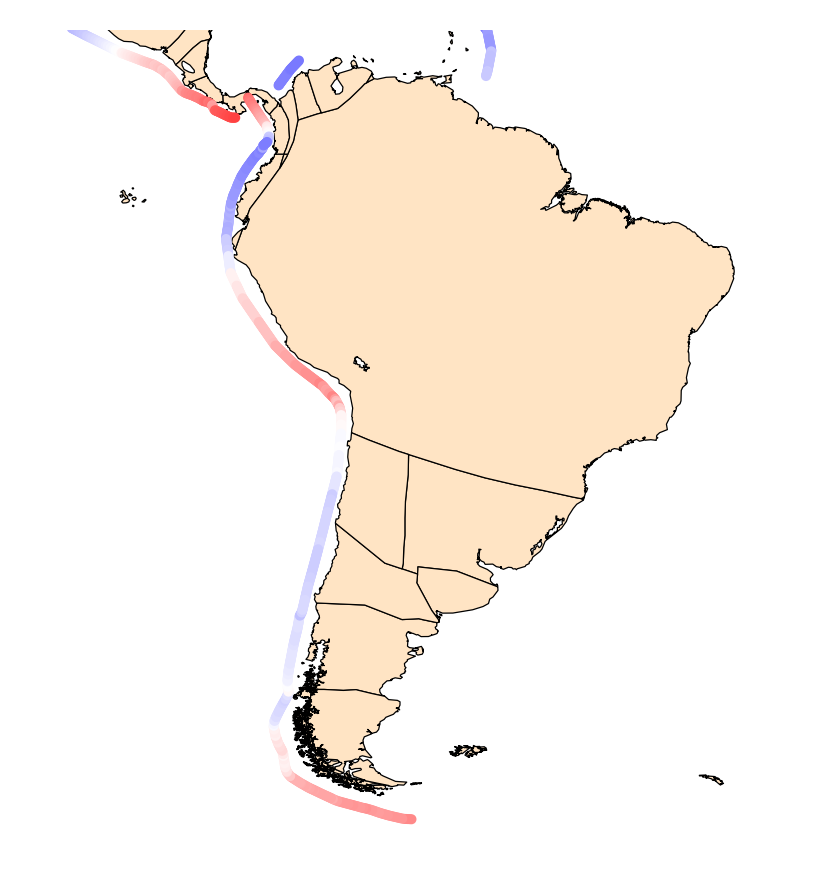

In [13]:
time=0
coastlines_gdf=gpd.read_file(coastlines)
delta=get_cpt.get_cmap("BlueDarkRed18.cpt")
fig,ax=plt.subplots(1,1,figsize=[3,3],dpi=300)
df=PK.get_subductiondf(time)
coastlines_gdf.plot(ax=ax,facecolor='bisque',edgecolor='k',lw=0.3,alpha=1.0)
df.plot(ax=ax,column='Migration Rate',cmap='seismic',markersize=2,legend=False,vmax=0.05,vmin=-0.05)
plt.xlim([-100,-30])
plt.ylim([-60,15])
plt.axis('off')
plt.tight_layout()
plt.savefig(f"{DEFAULT_OUTPUT_Figure}/Andes_MR_{time}.png",transparent=True)

# Filtering Mountains at subduction Zone

The unprocessed file with be save it as .parquet file. This will take a lot of time when run at high resolution

In [59]:
GMBA_file=PARAMS['InputFiles']['Area_of_Interest']

In [60]:
GMBA=gpd.read_file(GMBA_file) ## this is a comprehensive database of all the mountains. 
## more details https://www.earthenv.org/mountains

In [64]:
# Define the number of steps and reconstruction time for the subduction profile analysis
n_steps = 10
reconstruction_time = 0

# Get the dataframe for subduction data at the given reconstruction time
# with a tessellation threshold (degree of accuracy for segmentation)
subduction_df = PK.get_subductiondf(reconstruction_time, tessellation_threshold_deg=0.7)

# Initialize lists to store subduction lines and their normal angles
subduction_lines = []
normal_angle = []

# Loop through subduction data and create lines between consecutive trench points
for i in range(0, len(subduction_df) - 1):
    # Extract longitude and latitude of two consecutive trench points
    Point1 = (subduction_df.iloc[i]['Trench Longitude'], subduction_df.iloc[i]['Trench Latitude'])
    Point2 = (subduction_df.iloc[i + 1]['Trench Longitude'], subduction_df.iloc[i + 1]['Trench Latitude'])
    
    # Create a line between the two points
    lines = LineString([Point1, Point2])
    
    # Calculate the distance between the two points
    dist = lines.length
    
    # Filter lines based on their distance (if too far apart, ignore them)
    if dist <= 5.0:
        subduction_lines.append(lines)  # Append line if the distance is below threshold

# Initialize lists for storing profiles and trench coordinates
profiles = []
trench_lats = []
trench_lons = []

# Create profiles (perpendicular lines) along the subduction zones
for i in range(0, len(subduction_df) - 1):
    # Calculate offsets (dlon1 and dlat1) based on subduction normal angle and steps
    dlon1 = n_steps * np.sin(np.radians(subduction_df.iloc[i]['Subduction Normal Angle']))
    dlat1 = n_steps * np.cos(np.radians(subduction_df.iloc[i]['Subduction Normal Angle']))
    
    # Get current trench point's coordinates
    x1 = subduction_df.iloc[i]['Trench Longitude']
    y1 = subduction_df.iloc[i]['Trench Latitude']
    
    # Calculate end point for the perpendicular profile line
    ilon1 = x1 + dlon1
    ilat1 = y1 + dlat1
    
    # Create start and end points for the profile line (a small offset and final point)
    start_point = Point(x1 + 0.1 * dlon1, y1 + 0.1 * dlat1)
    end_point = Point(ilon1, ilat1)
    
    # Create profile as a LineString and append it to profiles list
    profile = LineString([start_point, end_point])
    profiles.append(profile)
    
    # Save trench coordinates for later use
    trench_lats.append(y1)
    trench_lons.append(x1)

# Initialize lists to store intersected points, profiles, and trench coordinates
intersected_points = []
intersected_profiles = []
intersected_trench_lats = []
intersected_trench_lons = []

# Check intersection between profiles and subduction lines
for i in range(len(profiles)):
    for subduction_line in subduction_lines:
        # Get the intersection between profile and subduction line
        intersection = profiles[i].intersection(subduction_line)
        
        # If the intersection is a point, save the relevant information
        if intersection.geom_type == 'Point':
            intersected_profiles.append(profiles[i])
            intersected_trench_lats.append(trench_lats[i])
            intersected_trench_lons.append(trench_lons[i])
            intersected_points.append(intersection)

# Create a GeoDataFrame to store the intersection data
Intersection_df = gpd.GeoDataFrame()
Intersection_df['Trench Latitude I'] = intersected_trench_lats
Intersection_df['Trench Longitude I'] = intersected_trench_lons
Intersection_df['Intersection Point'] = intersected_points
Intersection_df['Intersection Profile'] = intersected_profiles

# Extract latitude and longitude from intersection points
Intersection_df['Intersection Latitude'] = Intersection_df['Intersection Point'].apply(lambda p: p.y)
Intersection_df['Intersection Longitude'] = Intersection_df['Intersection Point'].apply(lambda p: p.x)

# Set geometry of the GeoDataFrame for spatial operations
Intersection_df = Intersection_df.set_geometry(gpd.points_from_xy(Intersection_df['Trench Longitude I'], Intersection_df['Trench Latitude I']))

# Perform a spatial join to find nearest subduction points to the intersection
result = gpd.sjoin_nearest(subduction_df, Intersection_df, how='left', max_distance=0.1)
result = result.reset_index()

# Set the index and fill missing intersection lat/lon based on subduction normal angle
result = result.set_index('index')
result['Intersection Latitude'] = result['Intersection Latitude'].fillna(result['Trench Latitude'] + n_steps * np.cos(np.radians(result['Subduction Normal Angle'])))
result['Intersection Longitude'] = result['Intersection Longitude'].fillna(result['Trench Longitude'] + n_steps * np.sin(np.radians(result['Subduction Normal Angle'])))

# Initialize lists to store points for profiles
slats = []
slons = []

# Generate multiple points (e.g., 20) between intersection and trench points
num_points = 20
for idx, row in result.iterrows():
    # Generate lat/lon points evenly spaced between intersection and trench points
    latitudes = np.linspace(row['Intersection Latitude'], row['Trench Latitude'] + 0.5 * np.cos(np.radians(row['Subduction Normal Angle'])), num_points)
    longitudes = np.linspace(row['Intersection Longitude'], row['Trench Longitude'] + 0.5 * np.sin(np.radians(row['Subduction Normal Angle'])), num_points)
    
    # Append generated points to lists
    slats.extend(latitudes)
    slons.extend(longitudes)

# Convert lat/lon lists to a GeoDataFrame for spatial operations
points_gdf = gpd.GeoDataFrame({
    "Trench Latitude": slats,
    "Trench Longitude": slons,
    "geometry": latlonlist2point(slats, slons)  # Convert lat/lon to Point geometry
})
points_gdf = points_gdf.set_crs(epsg=4326)  # Set CRS to WGS84 (EPSG:4326)


Using agegrid file : /Volumes/Satyam/STLR410MaM1/SeafloorAgegrid/agegrid_final_mask_0Ma.nc


/Users/ssin4735/miniconda3/envs/pygplates/lib/python3.10/site-packages/shapely/set_operations.py:131: RuntimeWarning:

invalid value encountered in intersection



In [65]:
GMBAc1=GMBA[GMBA['Hier_Lvl']==3].copy() ### group of mountains 
GMBAc2=GMBA[GMBA['Hier_Lvl']==4].copy() ### mountains range

In [66]:
# points_gdf=gpd.GeoDataFrame(points,geometry=gpd.points_from_xy(points['Longitude'],points['Latitude']))
points_gdf=points_gdf.set_crs(epsg=4326)
point_within_continents = gpd.sjoin(points_gdf,GMBAc2, how='inner', predicate='within')
point_within_continents=point_within_continents.drop_duplicates()
name_list=point_within_continents['MapName'].unique()
filtered_df2 = GMBAc2[GMBAc2['MapName'].isin(name_list)] ## all the mountains range

In [67]:
# points_gdf=gpd.GeoDataFrame(points,geometry=gpd.points_from_xy(points['Longitude'],points['Latitude']))
points_gdf=points_gdf.set_crs(epsg=4326)
point_within_continents = gpd.sjoin(points_gdf,GMBAc1, how='inner', predicate='within')
point_within_continents=point_within_continents.drop_duplicates()
name_list=point_within_continents['MapName'].unique()
filtered_df1 = GMBAc1[GMBAc1['MapName'].isin(name_list)]  ##group of mountains

In [68]:
print(f"Name of all mountains:{filtered_df2.MapName.unique()}")

Name of all mountains:['European Alps' 'Atlas Mountains' 'Alaska Range' 'Alborz Mountains'
 'Aleutian Ranges' 'Altiplano' 'Mexican Plateau' 'Apennine Mountains'
 'Balkan Mountains' 'Brooks Range' 'Carpathian Mountains' 'Cascade Range'
 'Coast Mountains' 'Cordillera Central' 'Cordillera de Guanacaste'
 'Cordillera de Talamanca' 'Cordillera de Mérida' 'Dinaric Alps'
 'Trans-Mexican Volcanic Belt' 'Greater Caucasus' 'Hamgyong Mountains'
 'Sikhote-Alin' 'Pontic Mountains' 'Lesser Caucasus' 'Mackenzie Mountains'
 'Massif Central' 'Rangnim Mountains' 'Olympic Mountains'
 'Península de Nicoya' 'Pyrenees' 'Rif' 'Serranía del Baudó'
 'Serranía de Pirre' 'Serranía de San Blas' 'Serranía de Tabasara'
 'Serranía del Sapo' 'Sierra de Ambato' 'Sierras de Córdoba'
 'Sierra de Famatina' 'Sierras de San Luis' 'Sierras de Valle Fertil'
 'Sierra de Velasco' 'Sierra Madre del Sur' 'Sierra Madre Occidental'
 'Sierra Madre Oriental' 'Sierra Nevada' 'Sierra Nevada de Santa Marta'
 'Baetic System' 'Sobaek Mou

In [69]:
zag=filtered_df2[filtered_df2['MapName']=='Zagros Mountains'].copy()

In [70]:
# List of mountain ranges to filter out
mountain_ranges_to_exclude = [
    "Atlas Mountains",
    "Zagros Mountains",
    "Baetic System",
    "Pyrenees"
]

# Filter out rows where 'MapName' is in the list of mountain ranges to exclude
filtered_df2 = filtered_df2[~filtered_df2['MapName'].isin(mountain_ranges_to_exclude)]

In [71]:
filtered_df2.to_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl4.shp")

In [72]:
# fig = plt.figure(figsize=[12,6], dpi=300)
# # gplot = gplately.PlotTopologies(model, coastlines=coastlines, continents=continents, time=time)

# # if mollweide:
# ax = fig.add_subplot(111, projection=ccrs.Mollweide(central_longitude = 0))
# ax.gridlines(color='0.7',linestyle='--', xlocs=np.arange(-180,180,30), ylocs=np.arange(-90,90,30))

# mollweide_proj = f"+proj=moll +lon_0={0} +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
# filtered_df2=filtered_df2.to_crs(mollweide_proj)
# # fig,ax=plt.subplots(1,1,figsize=[12,12])
# # plt.grid()
# # coastlines_gdf=gpd.
# filtered_df2.plot(ax=ax,facecolor='none',lw=0.1)
    
#         # Plot shapefile features, subduction zones and MOR boundaries at time Ma
# gplot.time = 0 # Ma
# # gplot.plot_continent_ocean_boundaries(ax, color='b', alpha=0.05)
# gplot.plot_continents(ax, facecolor='palegoldenrod', alpha=0.2)
# # gplot.plot_continents(ax, facecolor='grey', alpha=0.2)
# gplot.plot_coastlines(ax, color='skyblue',alpha=0.3)
# # gplot.plot_ridges_and_transforms(ax, color='red')
# gplot.plot_trenches(ax, color='k')
# gplot.plot_subduction_teeth(ax, color='k')
    

In [73]:
remove_geometry=zag.geometry.iloc[0]
filtered_df1['geometry'] = filtered_df1['geometry'].apply(lambda geom: geom.difference(remove_geometry))
filtered_df1.to_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl3.shp")

/Users/ssin4735/miniconda3/envs/pygplates/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Plotting the Filtered Mountains

In [74]:
# Define the groups and their symbols
groups = {
    'island arcs': 'o',   # Circle
    'noncollisional mountains': '^',   # Triangle
    'collisional mountains': 's'    # Rectangle
}
# vibrant blue
colorlist=["xkcd:lavender","xkcd:pink","xkcd:strong blue","xkcd:grapefruit","xkcd:neon purple","xkcd:bluish"]
# Define the colors for each group
group_colors = {
    'island arcs': colorlist,  # Distinct colors for island arcs

    'noncollisional mountains':colorlist,  # Distinct colors for noncollisional mountains
    'collisional mountains': colorlist  # Distinct colors for collisional mountains
    # 'noncollisional mountains': ['blue', 'dodgerblue', 'magenta', 'seagreen', 'brown', 'cyan'],  # Distinct colors for noncollisional mountains
    # 'collisional mountains': ['lime', 'slategray', 'coral', 'teal', 'indigo']  # Distinct colors for collisional mountains
}

# Define which mountains belong to which group
mountain_groups = {
    'Alaska-Yukon Ranges': 'noncollisional mountains',
    # 'Anatolian / Armenian Highlands': 'collisional mountains',
    'Balochistan Ranges': 'collisional mountains',
    'Caucasus Mountains': 'collisional mountains',
    'Central Andes': 'noncollisional mountains',
    'Hindu Kush': 'collisional mountains',
    'Iranian Plateau': 'collisional mountains',
    'Japanese Archipelago': 'island arcs',
    'Kamchatka Peninsula': 'island arcs',
    'Northern Andes': 'noncollisional mountains',
    'Pacific Coast Ranges':  'noncollisional mountains',
    'Solomon Islands': 'island arcs',
    'Lesser Antilles': 'island arcs',
    'South European Highlands': 'noncollisional mountains',
    'Southern Andes': 'noncollisional mountains',
       'Malay Archipelago':'island arcs'
}


Hindu Kush
Southern Andes
Central Andes
Northern Andes
Japanese Archipelago
Iranian Plateau
Pacific Coast Ranges
Kamchatka Peninsula
Malay Archipelago
Solomon Islands
Caucasus Mountains
Balochistan Ranges
Lesser Antilles
South European Highlands
Alaska-Yukon Ranges


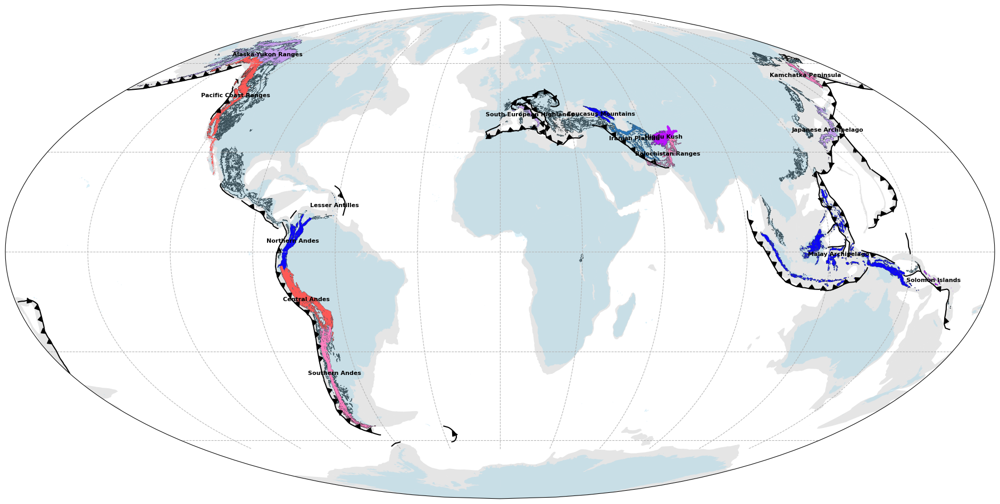

In [24]:

# If mollweide projection:
fig, ax = plt.subplots(1, 1, figsize=(24, 24), subplot_kw={'projection': ccrs.Mollweide(central_longitude=0)})
ax.gridlines(color='0.7', linestyle='--', xlocs=np.arange(-180, 180, 30), ylocs=np.arange(-90, 90, 30))

mollweide_proj = "+proj=moll +lon_0=0 +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
filtered_df2 = filtered_df2.to_crs(mollweide_proj)
filtered_df1 = filtered_df1.to_crs(mollweide_proj)
# Plot coastlines
filtered_df2.plot(ax=ax, facecolor='none', lw=0.4,alpha=1.0)

# Add polygons with colors based on group
for _, row in filtered_df1.iterrows():
    mountain_name = row['MapName']
    group = mountain_groups.get(mountain_name)
    if group:
        print(mountain_name)
        if mountain_name=="Iranian Plateau":
            result = row.geometry.difference(zag.geometry.iloc[0])
            
            color_idx = list(mountain_groups.keys()).index(mountain_name) % len(group_colors[group])
            color = group_colors[group][color_idx]
            ax.add_geometries([result], crs=ccrs.Mollweide(), facecolor=color, alpha=1.0)
            
        else:
            color_idx = list(mountain_groups.keys()).index(mountain_name) % len(group_colors[group])
            color = group_colors[group][color_idx]
            ax.add_geometries([row.geometry], crs=ccrs.Mollweide(), facecolor=color, alpha=1.0)

# Add mountain names as labels
for _, row in filtered_df1.iterrows():
    mountain_name = row['MapName']
    group = mountain_groups.get(mountain_name)
    if group:
        x, y = row.geometry.centroid.x, row.geometry.centroid.y
        ax.text(x, y, mountain_name, transform=ccrs.Mollweide(), ha='center', va='center', fontsize=8, color='black', weight='bold')

gplot.time = 0 # Ma
# gplot.plot_continent_ocean_boundaries(ax, color='b', alpha=0.05)
# gplot.plot_continents(ax, facecolor='palegoldenrod', alpha=0.2)
gplot.plot_continents(ax, facecolor='grey', alpha=0.2)
gplot.plot_coastlines(ax, color='skyblue',alpha=0.3)
# gplot.plot_ridges_and_transforms(ax, color='red')
gplot.plot_trenches(ax, color='k')
gplot.plot_subduction_teeth(ax, color='k')
    
# Create custom legend
handles = []
for group, symbol in groups.items():
    handle = mpatches.Patch(color=group_colors[group][0], label=group)  # Use the first color for the group
    handles.append(handle)

# plt.legend(handles=handles, loc='upper right')

plt.show()


In [31]:
### Load Seafloor Age grid

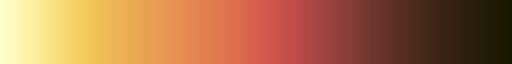

In [52]:
cmc.lajolla_r

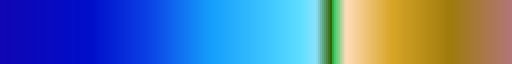

In [53]:
Etopo_REED

### This is just a better version of plot that takes a lot of time

In [37]:
### this will take a lot of time to plot. 

xkcd:lavender
xkcd:pink
xkcd:strong blue
xkcd:grapefruit
xkcd:neon purple
xkcd:bluish
xkcd:lavender
xkcd:pink
xkcd:strong blue
xkcd:grapefruit
xkcd:lavender
xkcd:pink
xkcd:strong blue
xkcd:grapefruit
xkcd:neon purple


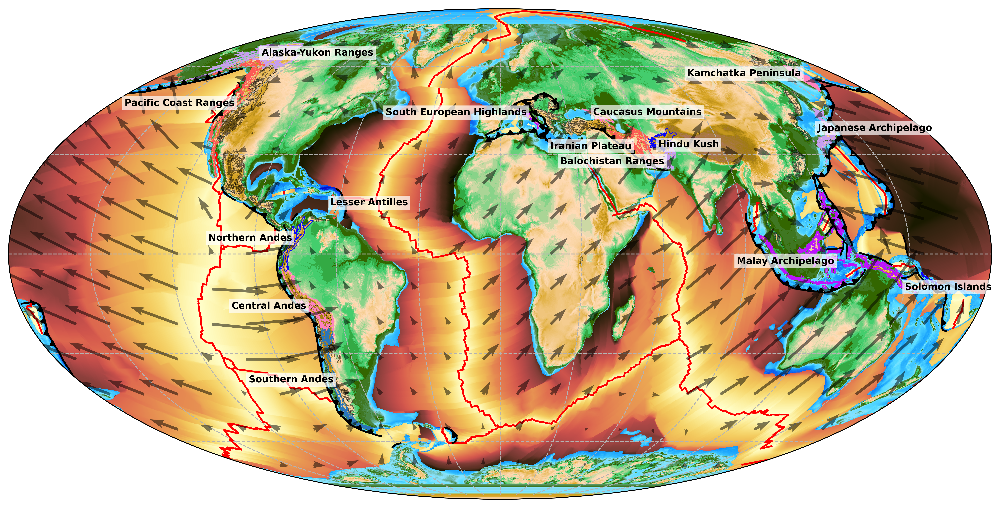

In [35]:
seafloor_age=xr.open_dataset(find_filename_with_number1(target_number=0,folder=agegrid))
topo=xr.open_dataset(ETOPO_FILE)


# If mollweide projection:
fig, ax = plt.subplots(1, 1, figsize=(15, 15),dpi=600, subplot_kw={'projection': ccrs.Mollweide(central_longitude=0)})
ax.gridlines(color='0.7', linestyle='--', xlocs=np.arange(-180, 180, 30), ylocs=np.arange(-90, 90, 30))

mollweide_proj = "+proj=moll +lon_0=0 +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
filtered_df2 = filtered_df2.to_crs(mollweide_proj)
filtered_df1 = filtered_df1.to_crs(mollweide_proj)

# Plot coastlines

# topo_coarse.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap=Etopo_REED, add_colorbar=False,robust=True,alpha=1.0)
topo.band_data.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap=Etopo_REED, add_colorbar=False,robust=True,alpha=1.0)
seafloor_age.z.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=180,vmin=0,cmap=cmc.lajolla_r,alpha=1.0,add_colorbar=False,
                         robust=True)
                        # cbar_kwargs={'orientation':'horizontal','shrink':0.2,
                        #                   'label':'Seafloor Age (Ma)'})

filtered_df2.plot(ax=ax, facecolor='none', lw=0.3, alpha=0.5)

j=0
for i in range(len(mountain_groups.keys())):
    mts=list(mountain_groups.keys())[i]
    if mountain_groups[mts]=='noncollisional mountains':
        print(group_colors[mountain_groups[mts]][j])
        dfc=filtered_df1[ filtered_df1['MapName'].isin([mts])].copy()
        
        dfc.plot(ax=ax, transform=ccrs.Mollweide(),lw=0.5, edgecolor=group_colors[mountain_groups[mts]][j],facecolor='None', alpha=1.0)
        j+=1
j=0
for i in range(len(mountain_groups.keys())):
    mts=list(mountain_groups.keys())[i]
    if mountain_groups[mts]=='collisional mountains':
        print(group_colors[mountain_groups[mts]][j])
        dfc=filtered_df1[ filtered_df1['MapName'].isin([mts])].copy()
        
        dfc.plot(ax=ax, transform=ccrs.Mollweide(),lw=0.5, edgecolor=group_colors[mountain_groups[mts]][j],facecolor='None', alpha=1.0)
        j+=1
j=0
for i in range(len(mountain_groups.keys())):
    mts=list(mountain_groups.keys())[i]
    if mountain_groups[mts]=='island arcs':
        print(group_colors[mountain_groups[mts]][j])
        dfc=filtered_df1[ filtered_df1['MapName'].isin([mts])].copy()
        
        dfc.plot(ax=ax, transform=ccrs.Mollweide(), edgecolor=group_colors[mountain_groups[mts]][j],facecolor='None', alpha=1.0)
        j+=1

# Collect text objects for adjustText
texts = []
for _, row in filtered_df1.iterrows():
    mountain_name = row['MapName']
    group = mountain_groups.get(mountain_name)
    if group:
        x, y = row.geometry.centroid.x, row.geometry.centroid.y
        text = ax.text(x, y, mountain_name, transform=ccrs.Mollweide(), ha='center', va='center', fontsize=8, color='black', weight='bold', bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', pad=2))
        texts.append(text)

# Adjust text to avoid overlap
adjust_text(texts, ax=ax, arrowprops=dict(arrowstyle="->", color='k', lw=0.5))

# Plot additional geographical features
gplot.time = 0 # Ma


# gplot.plot_continents(ax, facecolor='None', alpha=0.2)
# gplot.plot_coastlines(ax, color='None', alpha=0.3)
gplot.plot_ridges_and_transforms(ax, color='red')
gplot.plot_plate_motion_vectors(ax, regrid_shape=15, alpha=0.5, color='black', zorder=2)
gplot.plot_trenches(ax, color='k')
gplot.plot_subduction_teeth(ax, color='k')


plt.savefig(f"{OUTPUT_FOLDER}/Figure2a.png")
plt.show()


In [52]:
del points_gdf, filtered_df1, filtered_df2, profiles, trench_lats, trench_lons,result, slats,slons

## Creating Training Data

In [14]:
filtered_df=gpd.read_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl3.shp")

In [16]:
## In case you want to remove any mountain
# List of mountain ranges to filter out
mountain_ranges_to_exclude = [
    "Atlas Mountains",
    "Zagros Mountains",
    "Baetic System",
    "Pyrenees"
]

# mountains_to_remove=["Atlas Mountains"]
filtered_df = filtered_df[~filtered_df['MapName'].isin(mountain_ranges_to_exclude)]
print(f"Number of Mountains: {len(filtered_df)}")
Arcs=filtered_df.copy()

Number of Mountains: 47


In [17]:
## We will create a bunch of points inside the mountains using pyDTDM.utils.multipoints_from_shape()
# Define a function to process each arc
## this may take some time. If there are lots of polygons
def process_arc(arc):
    _, lat, lon = multipoints_from_shape(arc)
    return lat, lon

# Parallel processing of arcs using joblib
results = Parallel(n_jobs=-1)(delayed(process_arc)(arc) for _, arc in Arcs.iterrows())

# Extract latitudes and longitudes from the results
lats = [lat for lat_list, _ in results for lat in lat_list]
lons = [lon for _, lon_list in results for lon in lon_list]

# Create the DataFrame
dataset = pd.DataFrame({'Longitude': lons, 'Latitude': lats})
dataset=dataset.drop_duplicates()

print(f"Total number of points in the database = {len(dataset)}")


Total number of points in the database = 145501


In [18]:
# quickly check all the points. We will filter the points later
# plt.scatter(dataset['Longitude'],dataset['Latitude'],s=0.001)

In [19]:
## we will create gplately point object to reconstruct this points in deep time.
gpts = gplately.Points(PK.model, dataset['Longitude'], dataset['Latitude'])


In [20]:
training_data=f"{DEFAULT_OUTPUT_CSV}/Training_Data_Unprocessed" ## store the plate kinematics parameters
reconstruction_times = np.arange(0, 51)
create_directory_if_not_exists(training_data)

In [21]:
for rt in reconstruction_times:
    print(f"Starting Processing for Time={rt} Ma")

    reconstructed_subduction = all_sz_df[all_sz_df['Time']==rt].copy()
    reconstructed_subduction_gdf=gpd.GeoDataFrame(reconstructed_subduction,geometry=gpd.points_from_xy(reconstructed_subduction['Trench Longitude'],reconstructed_subduction['Trench Latitude']))
    print(f"Reconstructed Subduction Parameters for Time={rt} Ma")
    rlons, rlats = gpts.reconstruct(rt, return_array=True)
    reconstructed_df = gpd.GeoDataFrame({'Latitude': rlats, 'Longitude': rlons},geometry=gpd.points_from_xy(rlons,rlats))
    # print(type(reconstructed_df))

    combined_df = gpd.sjoin_nearest(reconstructed_df, reconstructed_subduction_gdf, how='left',distance_col='Trench Distance')
    print(f"Combining Data as a dataframe for Time={rt} Ma")
    combined_df.to_parquet(f"{training_data}/combined_df_{rt}.csv")


Starting Processing for Time=0 Ma
Reconstructed Subduction Parameters for Time=0 Ma
Combining Data as a dataframe for Time=0 Ma
Starting Processing for Time=1 Ma
Reconstructed Subduction Parameters for Time=1 Ma
Combining Data as a dataframe for Time=1 Ma
Starting Processing for Time=2 Ma
Reconstructed Subduction Parameters for Time=2 Ma
Combining Data as a dataframe for Time=2 Ma
Starting Processing for Time=3 Ma
Reconstructed Subduction Parameters for Time=3 Ma
Combining Data as a dataframe for Time=3 Ma
Starting Processing for Time=4 Ma
Reconstructed Subduction Parameters for Time=4 Ma
Combining Data as a dataframe for Time=4 Ma
Starting Processing for Time=5 Ma
Reconstructed Subduction Parameters for Time=5 Ma
Combining Data as a dataframe for Time=5 Ma
Starting Processing for Time=6 Ma
Reconstructed Subduction Parameters for Time=6 Ma
Combining Data as a dataframe for Time=6 Ma
Starting Processing for Time=7 Ma
Reconstructed Subduction Parameters for Time=7 Ma
Combining Data as a 

In [22]:
# Location for output
unprocessed_training_data=f"{DEFAULT_OUTPUT_CSV}/Training_Data_Unprocessed"
processed_training_data=f"{DEFAULT_OUTPUT_CSV}/Training_Data_Processed"
create_directory_if_not_exists(processed_training_data)

## Adding Climate Model

**Note**: Most of the climate model use Scotese and Wright (2018) paleoDEMS. The reference frame therefore are different 

In [23]:
df=pd.read_parquet(f"{unprocessed_training_data}/combined_df_0.csv")
data_folder="/Users/ssin4735/Documents/PROJECT/PhD Project/Codes and Data/Part 2/A_DEEPTIMETOPO/Data"
scotese_static_poly=f"{data_folder}/PALEOMAP Global Plate Model/PALEOMAP_PlatePolygons.gpml"
scotese_rotation=f"{data_folder}/PALEOMAP Global Plate Model/PALEOMAP_PlateModel.rot"
scotese_plate_model=gplately.PlateReconstruction(rotation_model=scotese_rotation,static_polygons=scotese_static_poly)
gpts_scotese= gplately.Points(scotese_plate_model, df['Longitude'], df['Latitude'])



In [24]:
CM=ClimateParameters(topology_filenames, 
                             rotation_filenames,
                             static_polygons,
                             agegrid=agegrid,
                             coastlines=coastlines,
                             continents=continents,
                             anchor_plate_id=Paleomag_ID)



RotationModel: No filename associated with <class 'pygplates.pygplates.RotationModel'> in __init__
 ensure pygplates is imported from gplately. Run,
 from gplately import pygplates


In [25]:
for t in reconstruction_times:
    print(f"Working on {t} Ma")
    rlons, rlats = gpts_scotese.reconstruct(t,return_array=True)
    coordinates = [(x, y) for x, y in zip(rlons, rlats)]
    raster_file = f"{data_folder}/Precipitation/Li++/Precip_Li_et_al{t}.nc"
    df=pd.read_parquet(f"{unprocessed_training_data}/combined_df_{t}.csv")
    ppt_data = rasterio.open(raster_file)
    ppt_array = ppt_data.read(1)  # Read the raster data again for KDE

    ppt = list(ppt_data.sample(coordinates))
    ppt=[ppt[i][0] for i in range(len(ppt))]
    df["Precipitation"]=ppt
    df.to_parquet(f"{processed_training_data}/Training_Data_{t}.csv")
    # plt.scatter(rlons,rlats,c=ppt)
print('Done')  

Working on 0 Ma
Working on 1 Ma
Working on 2 Ma
Working on 3 Ma
Working on 4 Ma
Working on 5 Ma
Working on 6 Ma
Working on 7 Ma
Working on 8 Ma
Working on 9 Ma
Working on 10 Ma
Working on 11 Ma
Working on 12 Ma
Working on 13 Ma
Working on 14 Ma
Working on 15 Ma
Working on 16 Ma
Working on 17 Ma
Working on 18 Ma
Working on 19 Ma
Working on 20 Ma
Working on 21 Ma
Working on 22 Ma
Working on 23 Ma
Working on 24 Ma
Working on 25 Ma
Working on 26 Ma
Working on 27 Ma
Working on 28 Ma
Working on 29 Ma
Working on 30 Ma
Working on 31 Ma
Working on 32 Ma
Working on 33 Ma
Working on 34 Ma
Working on 35 Ma
Working on 36 Ma
Working on 37 Ma
Working on 38 Ma
Working on 39 Ma
Working on 40 Ma
Working on 41 Ma
Working on 42 Ma
Working on 43 Ma
Working on 44 Ma
Working on 45 Ma
Working on 46 Ma
Working on 47 Ma
Working on 48 Ma
Working on 49 Ma
Working on 50 Ma
Done


# Getting Mean Parameters

In [10]:
processed_training_data=f"{DEFAULT_OUTPUT_CSV}/Training_Data_Processed"
### Loading the data
cumulative10=cumulative_subduction_params(training_data_folder=processed_training_data,
                                        starttime=0,endtime=WINDOW_SIZE)


list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list
list.remove(x): x not in list


In [10]:
cumulative10.columns

Index(['Latitude', 'Longitude', 'geometry', 'index_right', 'Trench Latitude',
       'Trench Longitude', 'Convergence Rate', 'Migration Rate',
       'Subduction Velocity', 'Obliquity Angle', 'Subduction Normal Angle',
       'Subduction Length', 'Subduction Plate Velocity',
       'Subduction Plate Obliquity', 'vratio', 'Nearest Trench Edge',
       'Start Edge Trench', 'Convergence Velocity Orthogonal',
       'Convergence Velocity Parallel', 'Trench Velocity Orthogonal',
       'Trench Velocity Parallel', 'Subducting Velocity Orthogonal',
       'Subducting Velocity Parallel', 'Subducting Plate ID',
       'Trench Plate ID', 'Subduction Volume Rate', 'Plate Thickness',
       'Subduction Flux', 'Time', 'Trench Distance', 'Precipitation'],
      dtype='object')

### plot the data

In [11]:
gdf_points=gpd.GeoDataFrame(cumulative10,geometry=latlonlist2point(cumulative10['Latitude'],cumulative10['Longitude']))
gdf_points=gdf_points.set_crs("EPSG:4326")


<GeoAxes: >

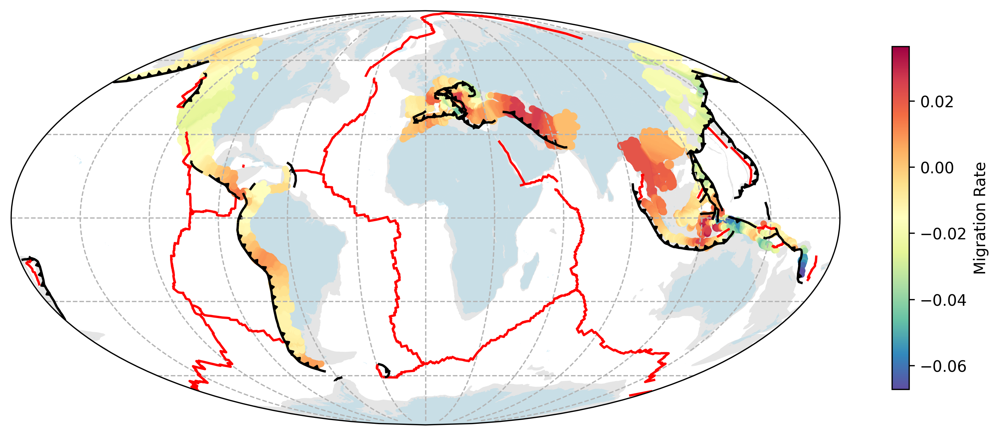

In [12]:
column_name="Migration Rate"
kwaargs={'cmap':'Spectral_r','label':f'{column_name}','figsize':(12,8)}
plotgdf(gdf_points, gplot,mollweide=True,column=column_name,quick=False,cbar=True,**kwaargs)

In [13]:
filtered_df2=gpd.read_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl4.shp")

## Filtering data point outside

In [14]:
## we will filter some of the mountains that we don't want
filtered_data=gpd.sjoin(gdf_points.drop(columns=['index_right']),filtered_df2.to_crs('epsg:4326'),how='left',predicate='intersects')

In [15]:
filtered_data = gpd.sjoin(gdf_points.drop(columns=['index_right']), 
                          filtered_df2.to_crs('epsg:4326'), 
                          how='left', 
                          predicate='within')


In [16]:

# Explode multipolygon geometries into individual polygons
filtered_df2_exploded = filtered_df2.explode(index_parts=False)

# Ensure both GeoDataFrames have the same CRS
gdf_points = gdf_points.to_crs('epsg:4326')
filtered_df2_exploded = filtered_df2_exploded.to_crs('epsg:4326')

# Perform the spatial join using the 'intersects' predicate
filtered_data = gpd.sjoin(gdf_points.drop(columns=['index_right']), filtered_df2_exploded, how='left', predicate='intersects')

# Filter out points that do not intersect with any polygon
filtered_data = filtered_data.dropna(subset=['index_right'])

# Get the filtered gdf_points with overlapping geometries
filtered_gdf_points = gdf_points[gdf_points.index.isin(filtered_data.index)]

# Visualize the result
# print(filtered_gdf_points)


<GeoAxes: >

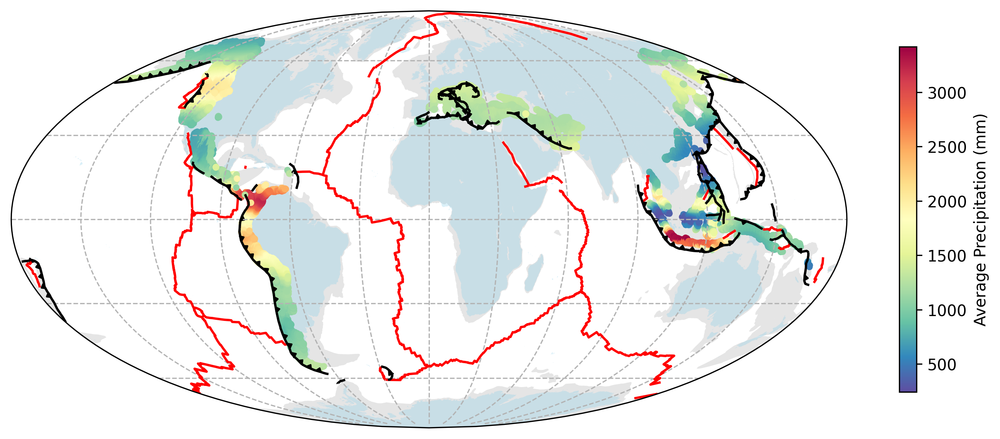

In [17]:
gdf_points=filtered_gdf_points.set_crs("EPSG:4326")
kwaargs={'cmap':'Spectral_r','label':f'Average Precipitation (mm)','figsize':(12,8)}
# plotgdf(gdf_points,mollweide=True,column="Subduction Volume Rate")
plotgdf(gdf_points, model=PK.model,mollweide=True,column="Precipitation",gplot=gplot,quick=False,cbar=True,**kwaargs)
# plotg

# Define Mantle Convection Parameters

This section of code will read all the input parameters for mantle convection model

In [18]:
# Input Files 
MANTLE_MODEL_NAME=PARAMS['InputFiles']['mantle_convection']['model_name']
MANTLE_MODEL_DIR = PARAMS['InputFiles']['mantle_convection']['model_dir']  ## plate model
MANTLE_topology_filenames =[f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['mantle_convection']['topology_files']]
MANTLE_rotation_filenames = [f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['mantle_convection']['rotation_files']]

MANTLE_depths= PARAMS['InputFiles']['mantle_convection']['depth']
MANTLE_vel_folder=PARAMS['InputFiles']['mantle_convection']['new_vel_folder']
MANTLE_temp_folder=PARAMS['InputFiles']['mantle_convection']['new_temp_folder']

MANTLE_org_vel=PARAMS['InputFiles']['mantle_convection']['original_vel_folder']
MANTLE_org_temp=PARAMS['InputFiles']['mantle_convection']['original_temp_folder']


MANTLE_velx_folder=PARAMS['InputFiles']['mantle_convection']['new_velx_folder']
MANTLE_org_velx=PARAMS['InputFiles']['mantle_convection']['original_velx_folder']

MANTLE_vely_folder=PARAMS['InputFiles']['mantle_convection']['new_vely_folder']
MANTLE_org_vely=PARAMS['InputFiles']['mantle_convection']['original_vely_folder']

MANTLE_visc_folder=PARAMS['InputFiles']['mantle_convection']['new_visc_folder']
MANTLE_org_visc=PARAMS['InputFiles']['mantle_convection']['original_visc_folder']

MANTLE_td_folder=PARAMS['InputFiles']['mantle_convection']['new_temp_dev_folder']
MANTLE_org_td=PARAMS['InputFiles']['mantle_convection']['original_temp_dev_folder']


print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print("Reading input file..... \n")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"Mantle Convection Plate Model: {MANTLE_MODEL_NAME} \n")
print(f"Mantle Convection Plate Model Directory: {MANTLE_MODEL_DIR} \n")

print(f"Mantle Convection Velocity: {MANTLE_vel_folder} \n")
print(f"Mantle Convection Temperature: {MANTLE_temp_folder} \n")

print(f"Mantle Convection Velocity: {MANTLE_org_vel} \n")
print(f"Mantle Convection Temperature: {MANTLE_org_temp} \n")

print(f"Mantle Convection Depths: {MANTLE_depths} \n")

print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– \n")

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Reading input file..... 

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Mantle Convection Plate Model: phase2 

Mantle Convection Plate Model Directory: /Users/ssin4735/Documents/PROJECT/PhD Project/Codes and Data/BhuDM/Zahirovic_etal_2022_GDJ_NNR 

Mantle Convection Velocity: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/vz_dimensional 

Mantle Convection Temperature: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/temp_dimensional 

Mantle Convection Velocity: /Volumes/Satyam/STLR410MaM1/STLR410MaM1/vz_dimensional 

Mantle Convection Temperature: /Volumes/Satyam/STLR410MaM1/STLR410MaM1/temp_dimensional 

Mantle Convection Depths: [16, 31, 47, 62, 140, 155, 171, 186, 202, 217, 233, 268, 293, 323, 357, 396, 439, 487, 540, 597, 660, 726, 798, 874, 954, 1040] 

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 



In [19]:
MT=MantleParameters(original_folder=MANTLE_org_temp,
                    new_folder=MANTLE_temp_folder,
                    parameter_type="Mantle_Temp", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
VZ=MantleParameters(original_folder=MANTLE_org_vel,
                    new_folder=MANTLE_vel_folder,
                    parameter_type="Mantle_Velocity", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
VX=MantleParameters(original_folder=MANTLE_org_velx,
                    new_folder=MANTLE_velx_folder,
                    parameter_type="Mantle_Velocity_X", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

VY=MantleParameters(original_folder=MANTLE_org_vely,
                    new_folder=MANTLE_vely_folder,
                    parameter_type="Mantle_Velocity_Y", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

VISC=MantleParameters(original_folder=MANTLE_org_visc,
                    new_folder=MANTLE_visc_folder,
                    parameter_type="Viscocity", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
TD=MantleParameters(original_folder=MANTLE_org_td,
                    new_folder=MANTLE_td_folder,
                    parameter_type="Temp_Dev", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'


### Interpolate Mantle Convection Data at each timesteps.

In case you don't have mantle parameters at uniform time step you can use a linear interpolation. Note that this will create a huge amount of data


In [42]:
# MT.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# VZ.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# VX.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# VY.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# VISC.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# TD.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)

Created directory: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/temp_deviation/1
Created directory: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/temp_deviation/2
Created directory: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/temp_deviation/3
Created directory: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/temp_deviation/4
Created directory: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/temp_deviation/5
Interpolation completed from 0 Ma to 6 Ma completed.
Created directory: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/temp_deviation/7
Created directory: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/temp_deviation/8
Created directory: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/temp_deviation/9
Interpolation completed from 6 Ma to 10 Ma completed.
Created directory: /Volumes/Satyam/Paleotopography/STLR410MaM1/STLR410MaM1/temp_deviation/11
Created directory: /Volumes/Satyam/Paleotopography/STLR410MaM1/S

# Extract Mantle Convection

This section of code will first read the data generated by PlateKinematics and then sample mantle parameters at every location. It will also track the point to calculate time a location spend in Humid Belt

In [20]:
cumulative10=filtered_gdf_points.drop(columns=['geometry'])

In [21]:
reconstruction_time=0
TrainingData=MT.get_mantle_parameters(cumulative10,reconstruction_time, depth_wise=True,n_jobs=parallel) ## getting mantle temp
TrainingData=VZ.get_mantle_parameters(TrainingData,reconstruction_time, depth_wise=True,n_jobs=parallel) ## getting vertical mantle vel


In [22]:
features=TrainingData.copy()

In [23]:
col2rm=[]
depths=[]
for depth in MANTLE_depths:
    col2rm.append(f'Mantle_Temp_{depth}')
    col2rm.append(f'Mantle_Velocity_{depth}')
    
    if (depth>200 and depth<=440):
        depths.append(depth)
        if depth==202:
            features['Mantle Temperature']=features[f'Mantle_Temp_{depth}']
            features['Mantle Velocity']=features[f'Mantle_Velocity_{depth}'] 
        else:  
            print(depth)
            features['Mantle Temperature']=features['Mantle Temperature']+features[f'Mantle_Temp_{depth}']
            features['Mantle Velocity']=features['Mantle Velocity']+features[f'Mantle_Velocity_{depth}']
    else:
        continue

    
features['Mantle Temperature']=features['Mantle Temperature']/len(depths)
features['Mantle Velocity']=features['Mantle Velocity']/len(depths)

217
233
268
293
323
357
396
439


In [24]:
features = features.drop(col2rm, axis=1)
features["Migration Rate"]=features["Migration Rate"]*1e2 # in cm/yr 


In [25]:
features.columns

Index(['Latitude', 'Longitude', 'index_right', 'Trench Latitude',
       'Trench Longitude', 'Convergence Rate', 'Migration Rate',
       'Subduction Velocity', 'Obliquity Angle', 'Subduction Normal Angle',
       'Subduction Length', 'Subduction Plate Velocity',
       'Subduction Plate Obliquity', 'vratio', 'Nearest Trench Edge',
       'Start Edge Trench', 'Convergence Velocity Orthogonal',
       'Convergence Velocity Parallel', 'Trench Velocity Orthogonal',
       'Trench Velocity Parallel', 'Subducting Velocity Orthogonal',
       'Subducting Velocity Parallel', 'Subducting Plate ID',
       'Trench Plate ID', 'Subduction Volume Rate', 'Plate Thickness',
       'Subduction Flux', 'Time', 'Trench Distance', 'Precipitation',
       'Mantle Temperature', 'Mantle Velocity'],
      dtype='object')

In [26]:
# features=features.drop(columns=['geometry','Latitude', 'Longitude', 'index_right', 'Trench Latitude',
#        'Trench Longitude','Start Edge Trench','Time','Subducting Plate ID',
#        'Trench Plate ID','vratio'])

# Multivariate Analysis

In [27]:
## select columns for Multivariate Analysis¶
columns_data=['Convergence Rate', 'Migration Rate',
       'Subduction Velocity', 'Obliquity Angle', 'Subduction Normal Angle',
       'Subduction Length', 'Subduction Plate Velocity',
       'Subduction Plate Obliquity', 'vratio', 'Nearest Trench Edge',
       'Start Edge Trench', 'Convergence Velocity Orthogonal',
       'Convergence Velocity Parallel', 'Trench Velocity Orthogonal',
       'Trench Velocity Parallel', 'Subducting Velocity Orthogonal',
       'Subducting Velocity Parallel', 'Subduction Volume Rate', 'Plate Thickness',
       'Subduction Flux', 'Trench Distance', 'Precipitation',
       'Mantle Temperature', 'Mantle Velocity','Elevation']

## Sample Elevation as Training Data points

In [28]:
ETopo=BhuRaster(folder_location=ETOPO_FILE,Raster_Type=ETOPO_Type)
features=ETopo.get_parameters(features)
features=features[columns_data]

In [29]:
list(features.columns)

['Convergence Rate',
 'Migration Rate',
 'Subduction Velocity',
 'Obliquity Angle',
 'Subduction Normal Angle',
 'Subduction Length',
 'Subduction Plate Velocity',
 'Subduction Plate Obliquity',
 'vratio',
 'Nearest Trench Edge',
 'Start Edge Trench',
 'Convergence Velocity Orthogonal',
 'Convergence Velocity Parallel',
 'Trench Velocity Orthogonal',
 'Trench Velocity Parallel',
 'Subducting Velocity Orthogonal',
 'Subducting Velocity Parallel',
 'Subduction Volume Rate',
 'Plate Thickness',
 'Subduction Flux',
 'Trench Distance',
 'Precipitation',
 'Mantle Temperature',
 'Mantle Velocity',
 'Elevation']

## Plot Correlation

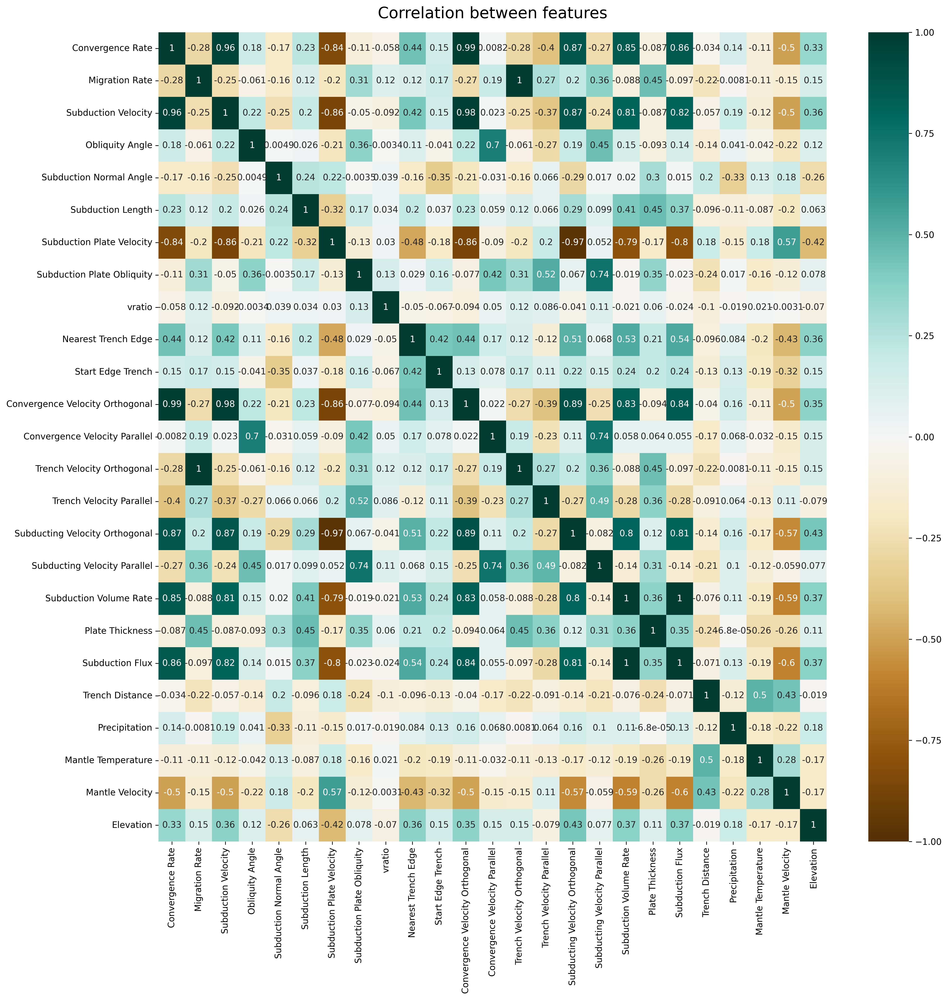

In [28]:
create_directory_if_not_exists(f"{OUTPUT_FOLDER}/Figure")
features_exp=features.copy
# mask = np.triu(np.ones_like(features.corr(), dtype=bool))
plt.figure(figsize=(16, 16),dpi=300)
heatmap = sns.heatmap(features.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
# heatmap = sns.heatmap(features.corr(), mask=mask, vmin=-1, vmax=1, annot=False, cmap='BrBG')
heatmap.set_title('Correlation between features', fontdict={'fontsize':18}, pad=16)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Correlation Heat Map1.png")
plt.show()

## Selecting the Best Features

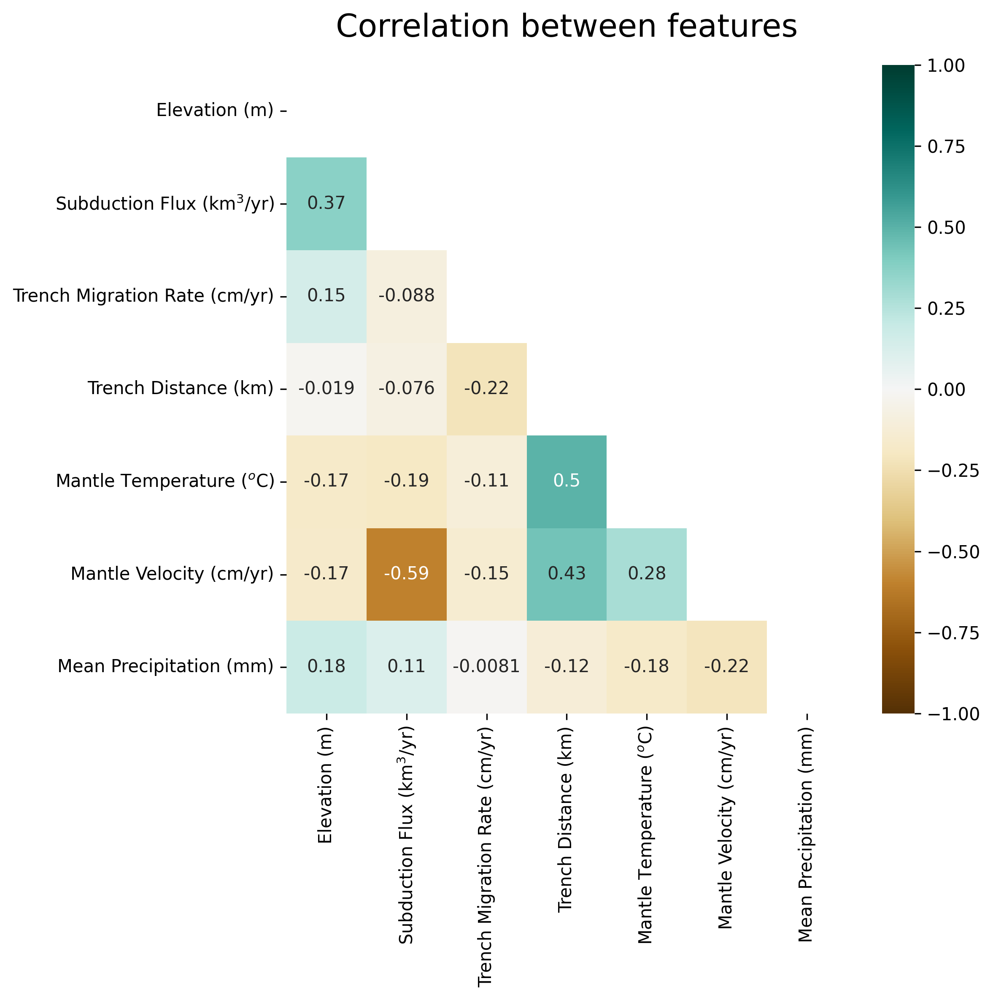

In [31]:
featuresc=pd.DataFrame()
featuresc['Elevation (m)']= features['Elevation']
featuresc['Subduction Flux (km$^3$/yr)']=features['Subduction Volume Rate']
featuresc['Trench Migration Rate (cm/yr)']=features['Migration Rate']
featuresc['Trench Distance (km)']=features['Trench Distance']
featuresc['Mantle Temperature ($^o$C)']=features['Mantle Temperature']
featuresc['Mantle Velocity (cm/yr)']=features['Mantle Velocity']
featuresc['Mean Precipitation (mm)']=features['Precipitation']
mask = np.triu(np.ones_like(featuresc.corr(), dtype=bool))
plt.figure(figsize=(8, 8),dpi=300)
heatmap = sns.heatmap(featuresc.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation between features', fontdict={'fontsize':18}, pad=16)
plt.tight_layout()
plt.savefig("Correlation Heat Map.png")
plt.show()

<Figure size 5400x7200 with 0 Axes>

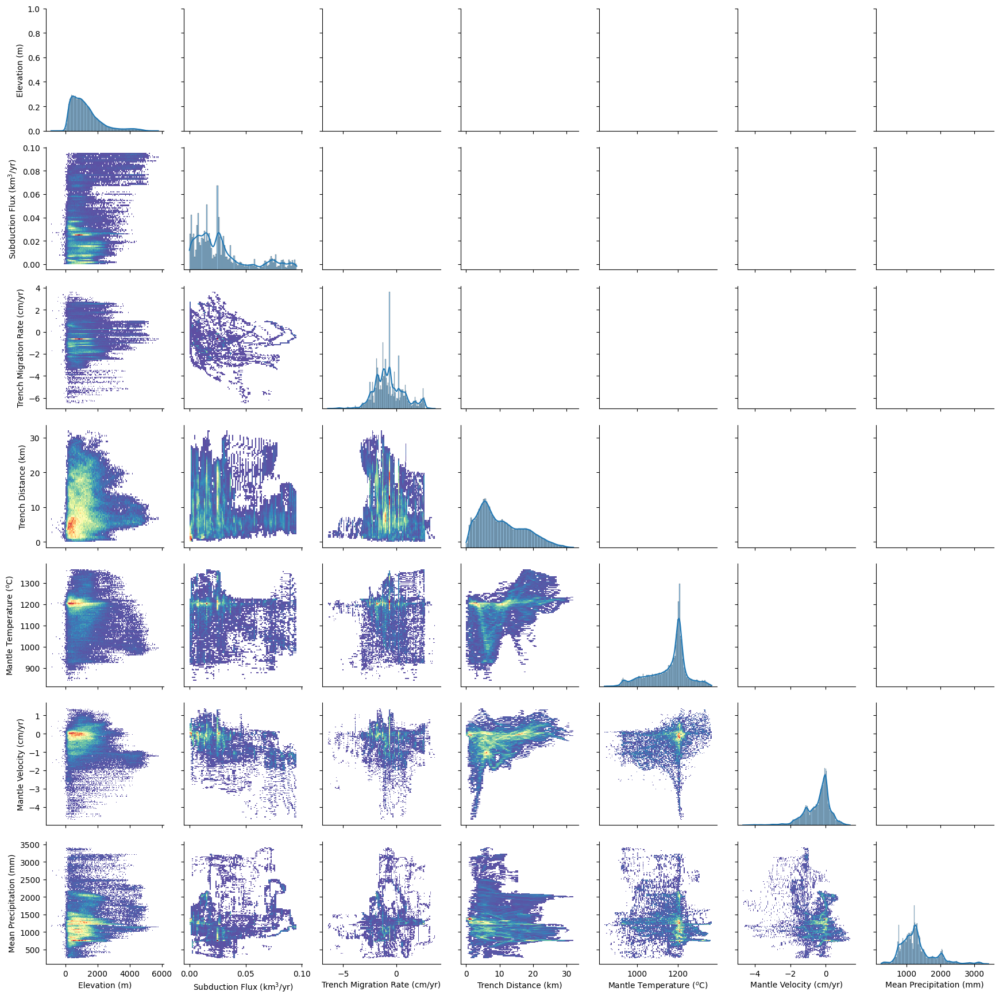

In [30]:
plt.figure(figsize=(18, 24),dpi=300)
g = sns.PairGrid(featuresc)
# g.map_lower(sns.kdeplot, fill=True,cmap="Spectral_r")
g.map_lower(sns.histplot, fill=True,cmap="Spectral_r")
g.map_diag(sns.histplot, kde=True)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Histogram.png")
plt.show()

# Plotting Training Features

In [32]:
gdf_points=gpd.GeoDataFrame(featuresc,geometry=gpd.points_from_xy(TrainingData['Longitude'],TrainingData['Latitude']))
gdf_points=gdf_points.set_crs("EPSG:4326")

In [33]:
gdf_points['Longitude']=TrainingData['Longitude']
gdf_points['Latitude']=TrainingData['Latitude']

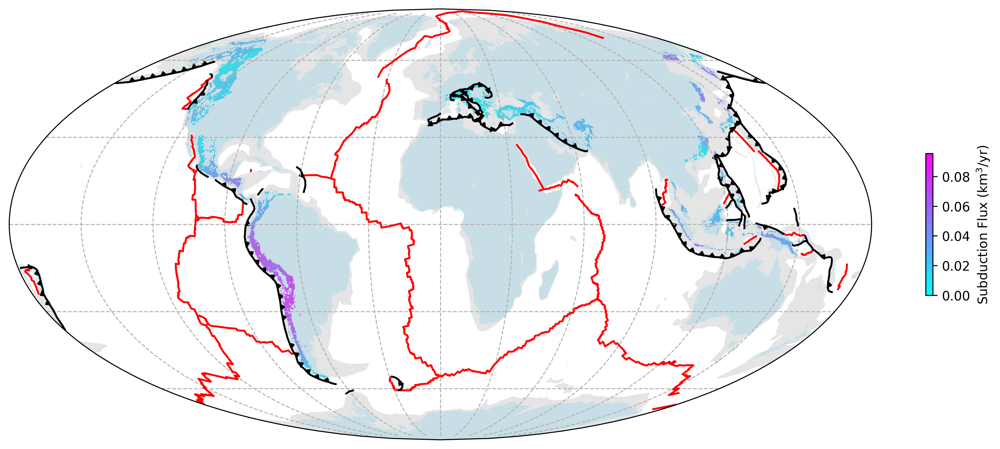

In [34]:
column="Subduction Flux (km$^3$/yr)"
kwaargs={'cmap':'cool','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1}
plotgdf(gdf_points,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Subduction Flux Rate.png")
plt.show()

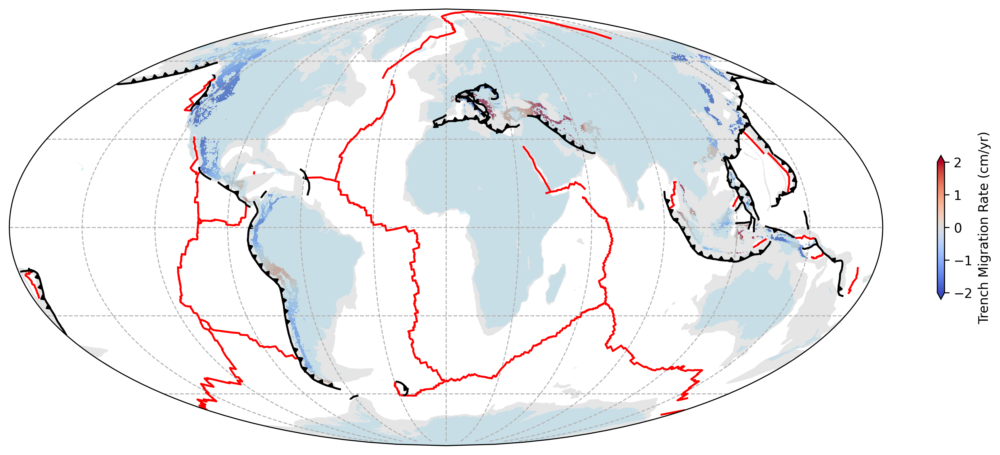

In [34]:
column='Trench Migration Rate (cm/yr)'
kwaargs={'cmap':'coolwarm','label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-2,'vmax':2,'extend':'both','markersize':0.1}
plotgdf(gdf_points,model=PK.model,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Trench Migration Rate.png")
plt.show()

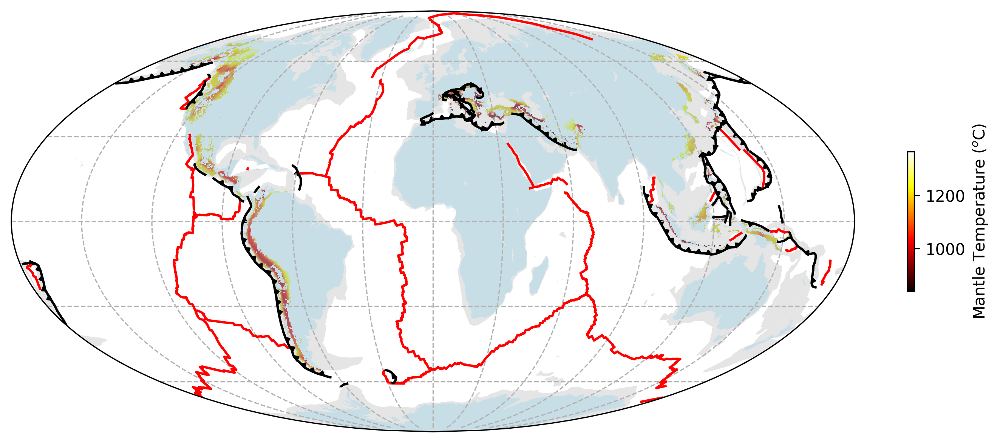

In [35]:
column='Mantle Temperature ($^o$C)'
kwaargs={'cmap':'hot','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1}
plotgdf(gdf_points,model=PK.model,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Mantle Temperature.png")
plt.show()

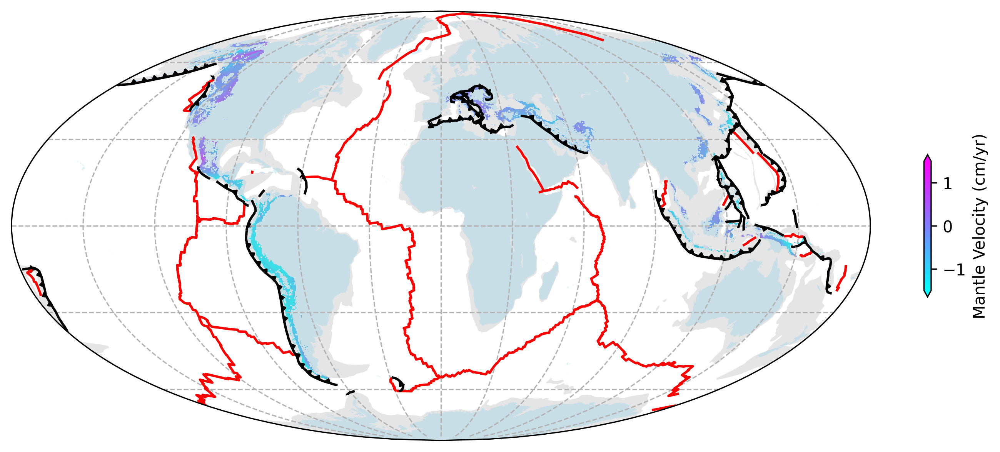

In [36]:
column='Mantle Velocity (cm/yr)'
kwaargs={'cmap':'cool','label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-1.5,'vmax':1.5,'extend':'both','markersize':0.1}
plotgdf(gdf_points,model=PK.model,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Mantle Velocity.png")

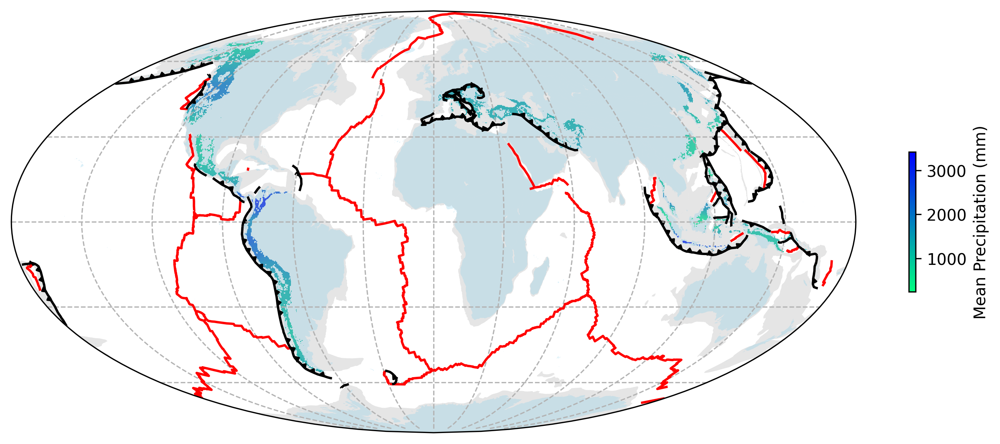

In [37]:
column='Mean Precipitation (mm)'
kwaargs={'cmap':'winter_r','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1}
plotgdf(gdf_points,model=PK.model,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Precipitation.png")

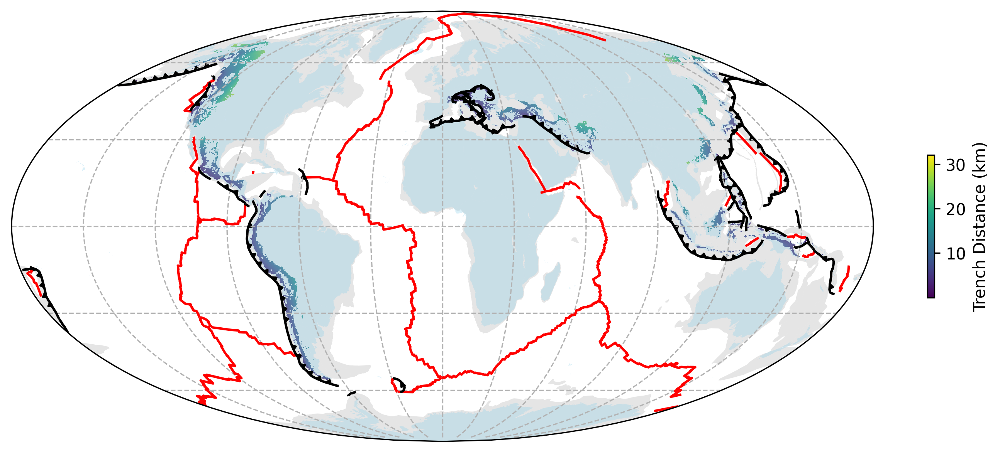

In [38]:
column='Trench Distance (km)'
kwaargs={'cmap':'viridis','label':f'{column}','figsize':(12,8),'shrink':0.2}
plotgdf(gdf_points,model=PK.model,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Trench Distance.png")
plt.show()

# Building a EBM model

In [45]:
X_train.columns

Index(['Subduction Flux (km$^3$/yr)', 'Trench Migration Rate (cm/yr)',
       'Trench Distance (km)', 'Mantle Temperature ($^o$C)',
       'Mantle Velocity (cm/yr)', 'Mean Precipitation (mm)'],
      dtype='object')

In [50]:
# features=featuresc.drop(columns=['Elevation (m)'])
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(featuresc.drop(columns=['Elevation (m)']), featuresc['Elevation (m)'], test_size=0.3, random_state=22)

# interactions=[(0,2),(1,2),(2,5)]
interactions=[(0,1),(0,2),(0,3),(0,4),(0,5),(1,2),(2,4),(2,5)]
ebm = ExplainableBoostingRegressor(learning_rate=1.1,
                                   interactions=interactions,
                                   # exclude=[(3)],
                                   # max_rounds=15000,
                                   # max_bins=2048,
                                   # max_interaction_bins=64,
                                   # max_leaves=6,
                                   # outer_bags=30,
                                   # inner_bags=0,
                                   # smoothing_rounds=500,
                                   random_state=22,
                                   n_jobs=-1)
ebm.fit(X_train, y_train.to_numpy())
# Make predictions on the test set
y_pred = ebm.predict( X_test)

# Calculate the root mean squared error
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("Root Mean Squared Error:", rmse)

/Users/ssin4735/miniconda3/envs/pygplates/lib/python3.10/site-packages/interpret/glassbox/_ebm/_ebm.py:723: UserWarning:

Missing values detected. Our visualizations do not currently display missing values. To retain the glassbox nature of the model you need to either set the missing values to an extreme value like -1000 that will be visible on the graphs, or manually examine the missing value score in ebm.term_scores_[term_index][0]



Root Mean Squared Error: 444.68034464623656


In [51]:
show(ebm.explain_global())

<!-- http://127.0.0.1:7001/15364007408/ -->

In [55]:
ebm.score(X_test,y_test)

0.7661903507327094

In [95]:
latitudes=TrainingData['Latitude']
longitudes= TrainingData['Longitude']

In [57]:
y_pred = ebm.predict(featuresc)
# Results=pd.DataFrame()
Results=featuresc.copy()
Results["Actual Elevation"]=featuresc['Elevation (m)']
Results["Latitude"]=latitudes
Results["Longitude"]=longitudes
Results["Predicted Elevation"]=y_pred
Results['Difference']=Results["Predicted Elevation"]-Results["Actual Elevation"]
Results_gdf=gpd.GeoDataFrame(Results,geometry=gpd.points_from_xy(longitudes,latitudes))
Results_gdf=Results_gdf.set_crs("EPSG:4326")

# Misfit Analysis

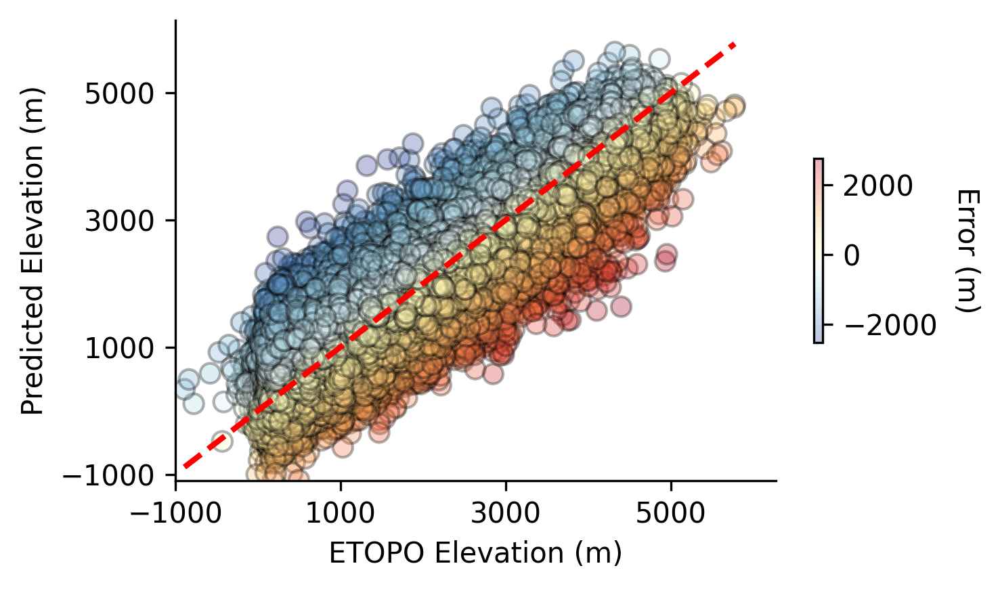

In [84]:


actual_elevation = Results_gdf["Actual Elevation"]
predicted_elevation = Results_gdf["Predicted Elevation"]

# # Calculate the point density
xy = np.vstack([actual_elevation, predicted_elevation])
z = gaussian_kde(xy)(xy)

# Create the plot
fig, ax = plt.subplots(figsize=(5, 3), dpi=300)

# Scatter plot with color mapping to density
sc = ax.scatter(actual_elevation, predicted_elevation, c=Results_gdf["Difference"], s=50, cmap='RdYlBu_r', edgecolor='k', alpha=0.3)

# Add a colorbar
cbar = plt.colorbar(sc, ax=ax,shrink=0.4)
cbar.set_label('Error (m)', rotation=270, labelpad=15)

# Plot the reference line (y=x)
ax.plot([min(actual_elevation), max(actual_elevation)], [min(actual_elevation), max(actual_elevation)], color='red', linestyle='--', linewidth=2)

# Labels and title
ax.set_xlabel('ETOPO Elevation (m)', fontsize=10)
ax.set_ylabel('Predicted Elevation (m)', fontsize=10)
# ax.set_title('Actual vs. Predicted Elevation', fontsize=16, weight='bold')

# Set axis limits and add grid
ax.set_xlim(min(actual_elevation), max(actual_elevation)+500)
ax.set_ylim(min(predicted_elevation), max(predicted_elevation)+500)
# ax.se
# ax.grid(True, linestyle='--', alpha=0.6)
ax.grid(False)
# Add legend
# ax.legend(loc='upper left', fontsize=12)
ax.xaxis.set_ticks(np.arange(-1000, 7000, 2000))
ax.yaxis.set_ticks(np.arange(-1000, 7000, 2000))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Misfit.png")
# Show plot

plt.show()


# Mountains wise elevation

In [85]:

filtered_df1=gpd.read_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl3.shp")
points_within=gpd.sjoin(Results_gdf,filtered_df1,how='left',predicate='within')
points_within=points_within[points_within['MapName'].isin(list(mountain_groups.keys()))]
# Example if you know the column names to include
mean_values = points_within.groupby(['MapName'])[['Actual Elevation']].mean()


In [86]:
# Initialize lists to store symbols and colors
symbols = []
colors = []

# Track color index for each group to cycle through colors
color_indices = {group: 0 for group in groups.keys()}

# Loop over the mean_values DataFrame and assign symbols and colors
for index in mean_values.index:
    mountain_group = mountain_groups[index]  # Find the group of the mountain
    symbol = groups[mountain_group]  # Get the symbol for the group
    
    # Get the color for the group and cycle through if needed
    color_list = group_colors[mountain_group]
    color_index = color_indices[mountain_group]
    color = color_list[color_index]
    
    # Update the color index for the next mountain in the same group
    color_indices[mountain_group] = (color_index + 1) % len(color_list)
    
    # Append symbol and color to respective lists
    symbols.append(symbol)
    colors.append(color)

# Add symbols and colors as columns to mean_values DataFrame
mean_values['Symbol'] = symbols
mean_values['Color'] = colors

# Display the updated DataFrame
print(mean_values)

                          Actual Elevation Symbol             Color
MapName                                                            
Alaska-Yukon Ranges             939.485046      ^     xkcd:lavender
Balochistan Ranges             1336.885864      s     xkcd:lavender
Caucasus Mountains             1537.524658      s         xkcd:pink
Central Andes                  2747.279541      ^         xkcd:pink
Hindu Kush                     2313.749512      s  xkcd:strong blue
Iranian Plateau                1684.323486      s   xkcd:grapefruit
Japanese Archipelago            562.578125      o     xkcd:lavender
Kamchatka Peninsula             649.628174      o         xkcd:pink
Lesser Antilles                 204.602951      o  xkcd:strong blue
Malay Archipelago               799.303467      o   xkcd:grapefruit
Northern Andes                 1719.436890      ^  xkcd:strong blue
Pacific Coast Ranges            968.890015      ^   xkcd:grapefruit
Solomon Islands                 407.672424      

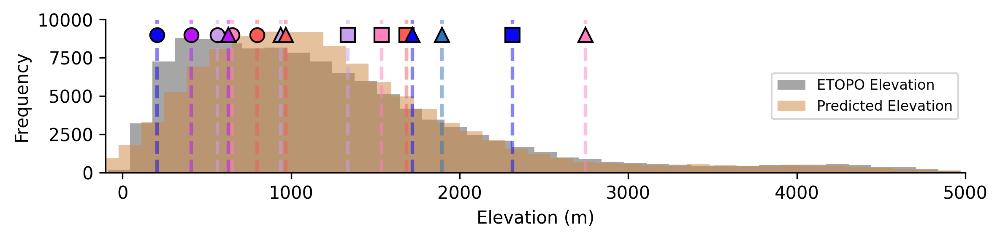

In [87]:
# import matplotlib.pyplot as plt
# import seaborn as sns

# Set style for publication quality
# sns.set(style="whitegrid")  # Use Seaborn's style for better aesthetics

# Create a figure and axis
fig, ax = plt.subplots(figsize=(8, 2),dpi=300)  # Set the figure size

# Plot the histogram for Actual Elevation
ax.hist(
    Results_gdf["Actual Elevation"],
    bins=50,  # Number of bins
    alpha=0.7,  # Transparency level for overlap
    color='gray',  # Color for Actual Elevation
    # edgecolor='black',  # Edge color for clarity
    label='ETOPO Elevation'  # Label for legend
)

# Plot the histogram for Predicted Elevation
ax.hist(
    Results_gdf["Predicted Elevation"],
    bins=50,  # Ensure the same number of bins for comparison
    alpha=0.5,  # Slightly more transparent for overlap visualization
    color='peru',  # Color for Predicted Elevation
    # edgecolor='black',  # Edge color for clarity
    label='Predicted Elevation'  # Label for legend
)

# Overlay vertical lines at actual elevation values with corresponding colors and symbols
for index, row in mean_values.iterrows():
    # Extract values
    actual_elevation = row['Actual Elevation']
    color = row['Color']
    symbol = row['Symbol']
    
    # Plot the vertical line with symbol
    ax.axvline(
        x=actual_elevation,
        alpha=0.5,
        color=color,
        linestyle='--',
        linewidth=2,
        # label=f'{index} (Mean Elevation)'
    )
    
    # Overlay the symbol at the mean elevation value
    ax.plot(
        actual_elevation,  # X position
        9000,  # Y position (adjust as needed, here 0 to ensure it's visible)
        marker=symbol,
        color=color,
        markersize=8,
        markeredgecolor='k',
        # label=f'{index} Symbol'
    )

ax.grid(False)
# Set axis labels
ax.set_xlabel('Elevation (m)', fontsize=10)
ax.set_ylabel('Frequency', fontsize=10)

# Set title
# ax.set_title('Comparison of Actual vs. Predicted Elevation', fontsize=15)

# Add a legend to differentiate the histograms
ax.legend(fontsize=8,loc='center right')
ax.grid(False)
# Turn off top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylim([0,10000])
ax.set_xlim([-100,5000])
# Save the figure in high resolution
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/elevation_comparison_histogram.png", dpi=300)

# Show the plot
plt.show()


In [88]:
mountain_names=mean_values.index
# Organize mountain names by group
sorted_mountains = {
    'island arcs': [name for name, group in mountain_groups.items() if group == 'island arcs'],
    'noncollisional mountains': [name for name, group in mountain_groups.items() if group == 'noncollisional mountains'],
    'collisional mountains': [name for name, group in mountain_groups.items() if group == 'collisional mountains']
}

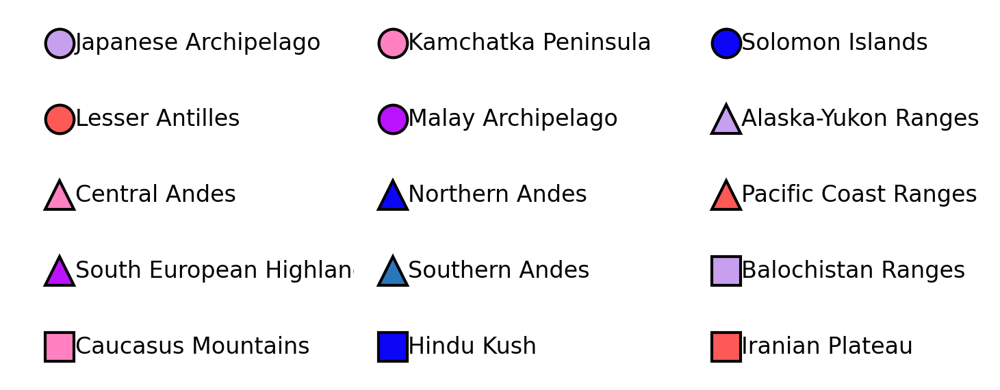

In [89]:

# Create the figure and axes
fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(4.7, 2), dpi=300)
axes = axes.flatten()  # Flatten the 2D array of axes

# Plot each mountain name, symbol, and color
idx = 0
for group, names in sorted_mountains.items():
    symbol = groups[group]
    colors = group_colors[group]
    for name, color in zip(names, colors):
        axes[idx].plot(
            0.5,  # X position
            0.5,  # Y position
            marker=symbol,
            color=color,
            markersize=10,
            markeredgecolor='black',  # Outline color
            markeredgewidth=1,  # Outline width
            linestyle='None'
        )
        axes[idx].text(0.7, 0.5, name, ha='left', va='center', fontsize=8)
        axes[idx].set_xlim(0, 1.4)
        axes[idx].set_ylim(0, 1)
        axes[idx].set_xticks([])
        axes[idx].set_yticks([])
        axes[idx].spines['top'].set_visible(False)
        axes[idx].spines['right'].set_visible(False)
        axes[idx].spines['left'].set_visible(False)
        axes[idx].spines['bottom'].set_visible(False)
        idx += 1

# Adjust layout
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/mountain_symbols_panel.png", dpi=300, bbox_inches='tight')
plt.show()


In [90]:
Results_gdf['Difference']=Results_gdf["Actual Elevation"]-Results_gdf["Predicted Elevation"]

In [91]:
Arcs=GMBA[GMBA['Hier_Lvl']==3].copy()

In [94]:
# latitudes

array([20.26921135, 20.44429126, 20.61937118, 20.79445109, 20.969531  ,
       21.14461092, 21.31969083, 21.49477075, 21.66985066, 21.84493057,
       22.02001049, 22.1950904 , 22.37017032, 22.54525023, 22.72033015,
       22.89541006, 23.07048997, 23.24556989, 23.4206498 , 23.59572972])

##  Parameters

In [97]:
gdf_points=gpd.GeoDataFrame(featuresc,geometry=gpd.points_from_xy(longitudes,latitudes))
gdf_points=gdf_points.set_crs("EPSG:4326")
gdf_points = gpd.sjoin(gdf_points, Arcs, predicate='within')
columns_to_exclude = ['geometry', 'index_right', 'GMBA_V2_ID',
       'GMBA_V1_ID', 'WikiDataUR', 'MapUnit', 'Hier_Lvl', 'Feature',
       'Area', 'Perimeter', 'Elev_Low', 'Elev_High', 'Path', 'Path_ID',
       'Level_01', 'Level_02', 'Level_03', 'Level_04', 'Level_05', 'Level_06',
       'Level_07', 'Level_08', 'Level_09', 'Level_10', 'Select_300',
       'Countries', 'CountryISO', 'DBaseName', 'AsciiName', 'Name_AR',
       'Name_DE', 'Name_EN', 'Name_ES', 'Name_FR', 'Name_PT', 'Name_RU',
       'Name_ZH', 'LocalNames', 'ColorAll', 'ColorBasic', 'Color300']
parameter_mts = gdf_points.drop(columns_to_exclude, axis=1).groupby('MapName').mean()
# parameter_mts = parameter_mts.select_dtypes(include='number').groupby('MapName').mean()


In [98]:
parameter_mts

,Elevation (m),Subduction Flux (km$^3$/yr),Trench Migration Rate (cm/yr),Trench Distance (km),Mantle Temperature ($^o$C),Mantle Velocity (cm/yr),Mean Precipitation (mm)
MapName,,,,,,,
Alaska-Yukon Ranges,939.485046,0.021364,-0.779531,17.426877,1234.395996,-0.027484,933.716479
Anatolian / Armenian Highlands,1397.450562,0.008978,1.092189,6.230705,1122.470825,-0.308083,1257.876178
Balochistan Ranges,1336.885864,0.026717,0.425271,8.564366,1139.223145,-0.398489,1347.896653
Bismarck Archipelago,573.911987,0.043041,-1.076631,2.034266,1185.976562,-1.787176,1163.651105
Caucasus Mountains,1537.524658,0.011312,1.941386,10.696676,1123.321655,-0.644777,1310.739901
Central America Volcanic Arc,296.989349,0.057022,0.531826,3.799511,1205.198730,-1.928504,1663.164094
Central Andes,2747.279541,0.079943,0.254648,8.534244,1110.885864,-1.569384,1825.759504
Central European Highlands,1268.704956,0.001134,0.533191,1.398539,1098.419556,0.035383,1367.954488
Chorotega Highlands*,866.797424,0.032990,1.252814,2.823932,1198.812744,-2.604183,2612.117277


# EBM Explanation

In [99]:
explanation_dic=ebm.explain_global().__dict__
names=explanation_dic["_internal_obj"]['overall']['names']

In [100]:
explanation_dic_local=ebm.explain_local(featuresc, featuresc['Elevation (m)']).__dict__

In [101]:
local_exp=pd.DataFrame()
new_rows_list=[]
predicted=[]
actual=[]
# Assuming you have a loop to iterate over different values of i
for i in range(len(explanation_dic_local["_internal_obj"]['specific'])):
    column_names = explanation_dic_local["_internal_obj"]['specific'][i]['names']
    values = explanation_dic_local["_internal_obj"]['specific'][i]['scores']
    
    actual.append(explanation_dic_local["_internal_obj"]['specific'][i]['perf']['actual'])
    predicted.append(explanation_dic_local["_internal_obj"]['specific'][i]['perf']['predicted'])
    
    name_value_dict = dict(zip(column_names, values))
    new_rows_list.append(name_value_dict)
local_exp = pd.DataFrame(new_rows_list)
# local_exp=local_exp/1495  

    

In [102]:
local_exp['Actual Elevation']=actual
local_exp['Predicted Elevation']=predicted
# local_exp['Error']=abs(local_exp['Smoothed Elevation']-local_exp['Predicted'])
local_exp_gdf=gpd.GeoDataFrame(local_exp,geometry=gpd.points_from_xy(longitudes,latitudes))
local_exp_gdf=local_exp_gdf.set_crs("epsg:4326")

In [103]:

points_within_arcs = gpd.sjoin(local_exp_gdf, Arcs, predicate='within')

local_exp_mts = points_within_arcs.drop(columns_to_exclude, axis=1).groupby('MapName').mean()

In [104]:
local_exp_mts.columns

Index(['Subduction Flux (km$^3$/yr)', 'Trench Migration Rate (cm/yr)',
       'Trench Distance (km)', 'Mantle Temperature ($^o$C)',
       'Mantle Velocity (cm/yr)', 'Mean Precipitation (mm)',
       'Subduction Flux (km$^3$/yr) & Trench Migration Rate (cm/yr)',
       'Subduction Flux (km$^3$/yr) & Trench Distance (km)',
       'Subduction Flux (km$^3$/yr) & Mantle Temperature ($^o$C)',
       'Subduction Flux (km$^3$/yr) & Mantle Velocity (cm/yr)',
       'Subduction Flux (km$^3$/yr) & Mean Precipitation (mm)',
       'Trench Migration Rate (cm/yr) & Trench Distance (km)',
       'Trench Distance (km) & Mantle Velocity (cm/yr)',
       'Trench Distance (km) & Mean Precipitation (mm)', 'Actual Elevation',
       'Predicted Elevation'],
      dtype='object')

## Geospatial Explanation

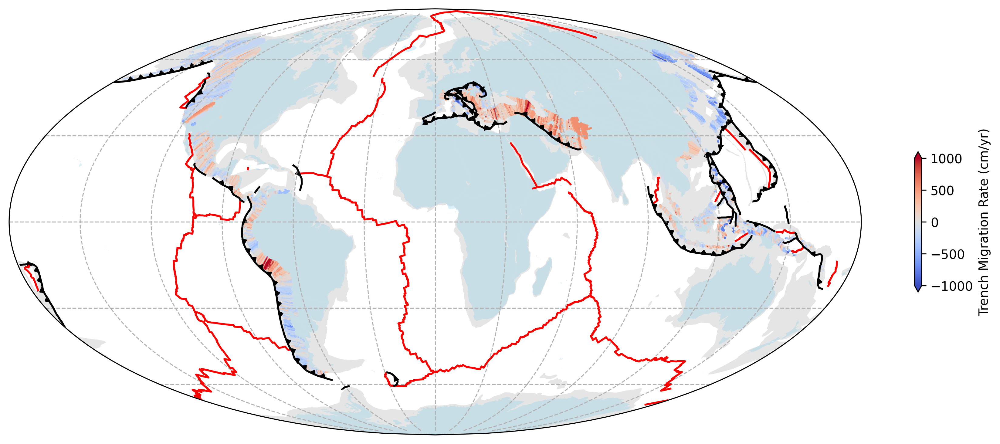

In [105]:
column='Trench Migration Rate (cm/yr)'
kwaargs={'cmap':'coolwarm','label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-1000,'vmax':1000,'markersize':0.1,'extend':'both'}
ax=plotgdf(local_exp_gdf,mollweide=True,quick=False,column=column,gplot=gplot,cbar=True,**kwaargs)
# topo_coarse.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap=Etopo_REED, add_colorbar=False,robust=True,alpha=1.0)

# ax=plotgdf(local_exp_gdf,model=PK.model,mollweide=True,column=column,cbar=True,**kwaargs)
plt.tight_layout()
# topo_coarse.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap=Etopo_REED, add_colorbar=False,robust=True,alpha=1.0)

plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explaination_Trench_Migration_Rate.png")
plt.show()

In [106]:
subtle=get_cpt.get_cmap('delta.cpt')
diff=get_cpt.get_cmap('differences.cpt')


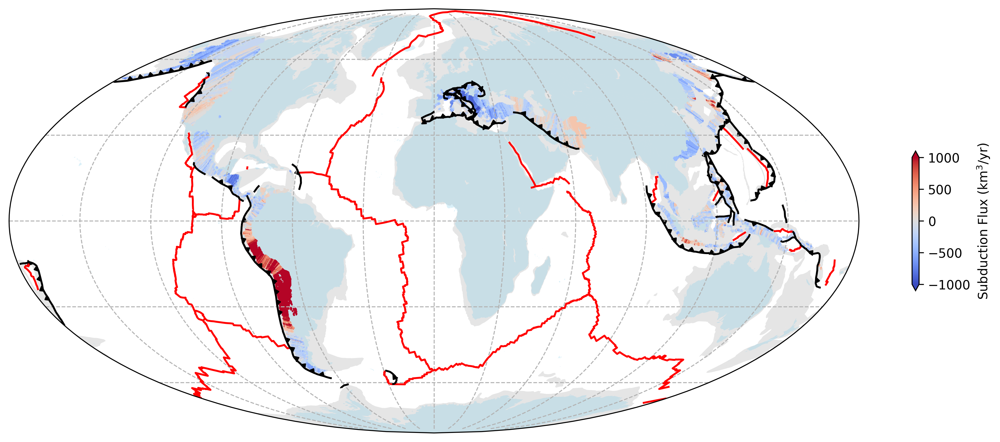

In [107]:
column="Subduction Flux (km$^3$/yr)"
kwaargs={'cmap':'coolwarm','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1,'vmin':-1000,'vmax':1000,'extend':'both'}
# topo_coarse.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap='grey', add_colorbar=False,robust=True,alpha=1.0)
plotgdf(local_exp_gdf,quick=False,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explanation_Subduction_Flux_Rate.png")
plt.show()

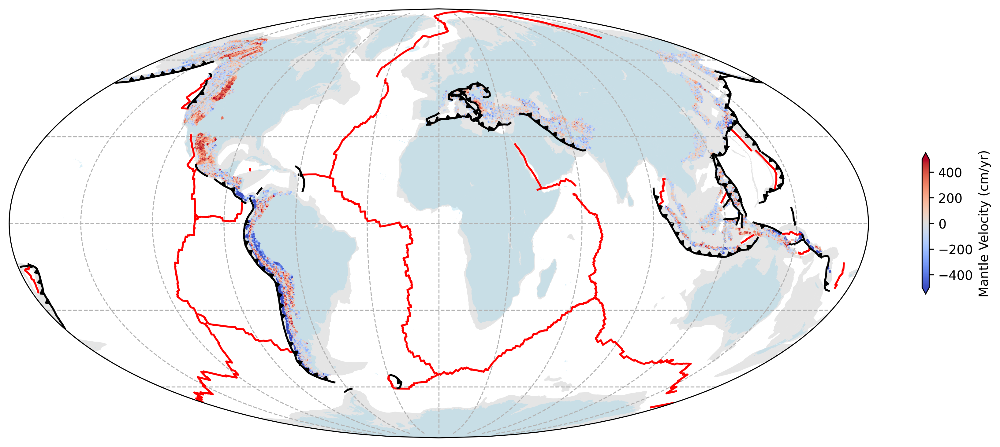

In [108]:
column="Mantle Velocity (cm/yr)"
kwaargs={'cmap':'coolwarm','label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-500,'vmax':500,'extend':'both','markersize':0.1,}
plotgdf(local_exp_gdf,quick=False,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explanation_Vertical_Mantle_Flow.png")
plt.show()

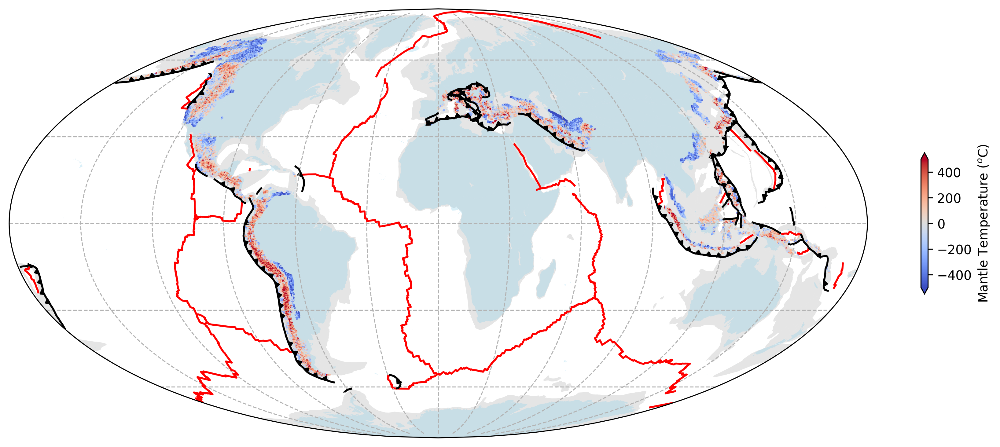

In [109]:
column='Mantle Temperature ($^o$C)'
kwaargs={'cmap':'coolwarm','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1,'vmin':-500,'vmax':500,'extend':'both'}
plotgdf(local_exp_gdf,quick=False,mollweide=True,column=column,gplot=gplot,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explanation_Mantle_Temperature.png")
plt.show()

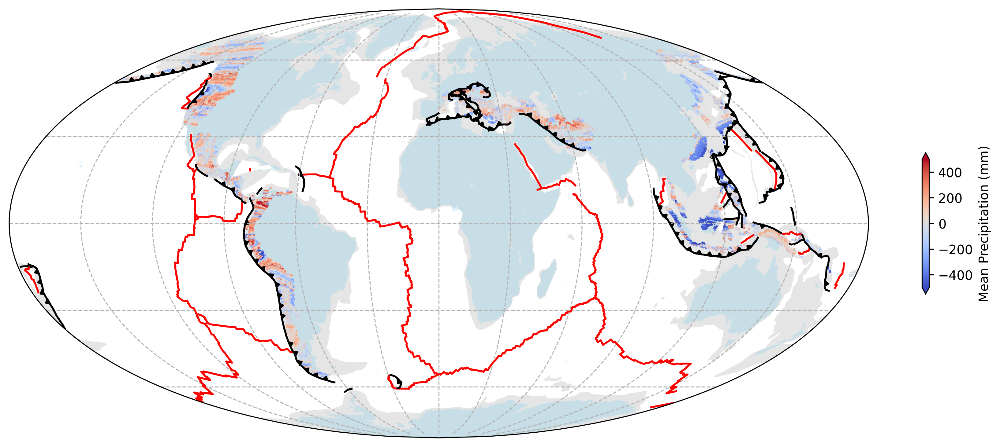

In [110]:
column='Mean Precipitation (mm)'
kwaargs={'cmap':'coolwarm','label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-500,'vmax':500,'extend':'both','markersize':0.1}
plotgdf(local_exp_gdf,quick=False,mollweide=True,column=column,gplot=gplot,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explanation_Precipitation.png")
plt.show()

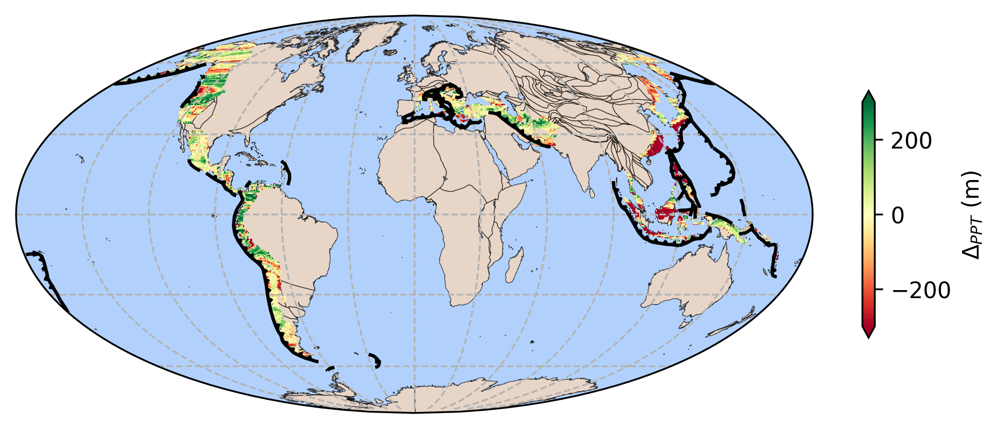

In [140]:
column='Mean Precipitation (mm)'
mollweide=True
features=True
cbar=True
figsize=[8,4]
fig = plt.figure(figsize=figsize, dpi=300)
vmin,vmax=-1000,1000
central_longitude=0
cmap=cmc.batlow
orientation='vertical'
extend='both'
shrink=0.4
label=f"$ \mathregular{{\Delta}}_{{PPT}}$ (m)"
# gplot = gplately.PlotTopologies(model, coastlines=coastlines, continents=continents, time=time)

nc=df_to_NetCDF(x=local_exp_gdf.geometry.x,y=local_exp_gdf.geometry.y,z=local_exp_gdf['Mean Precipitation (mm)'],grid_resolution=0.5)

if mollweide:
    ax = fig.add_subplot(111, projection=ccrs.Mollweide(central_longitude = central_longitude))
    ax.gridlines(color='0.7',linestyle='--', xlocs=np.arange(-180,180,30), ylocs=np.arange(-90,90,30))

    mollweide_proj = f"+proj=moll +lon_0={central_longitude} +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
    local_exp_gdfc=local_exp_gdf.to_crs(mollweide_proj).copy()
else:
    ax = fig.add_subplot(111, projection=ccrs.PlateCarree(central_longitude = central_longitude))
    ax.gridlines(color='0.7',linestyle='--', xlocs=np.arange(-180,180,15), ylocs=np.arange(-90,90,15))

# nc.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=500,vmin=-500,cmap=subtle, add_colorbar=False,robust=True,alpha=0.3)
      
    
if features:

    # Plot shapefile features, subduction zones and MOR boundaries at time Ma
    gplot.time = 0 # Ma
    # gplot.plot_continent_ocean_boundaries(ax, color='b', alpha=0.05)
    # gplot.plot_continents(ax, facecolor='palegoldenrod', alpha=0.2)
    # gplot.plot_continents(ax, facecolor='grey', alpha=0.2)
    gplot.plot_coastlines(ax, color='xkcd:light peach',edgecolor='k',alpha=0.7,lw=0.3)
    # gplot.plot_ridges_and_transforms(ax, color='red')
    gplot.plot_trenches(ax, color='k')
    gplot.plot_subduction_teeth(ax, color='k')



    # Plot the GeoDataFrame
nc.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=300,vmin=-300,cmap="RdYlGn", add_colorbar=True,robust=True,alpha=1.0,
        cbar_kwargs={'orientation':'vertical','shrink':0.5,
                                          'label':label})
    
ax.set_facecolor('xkcd:powder blue')
ax.set_global()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Contribution_PPT.png")

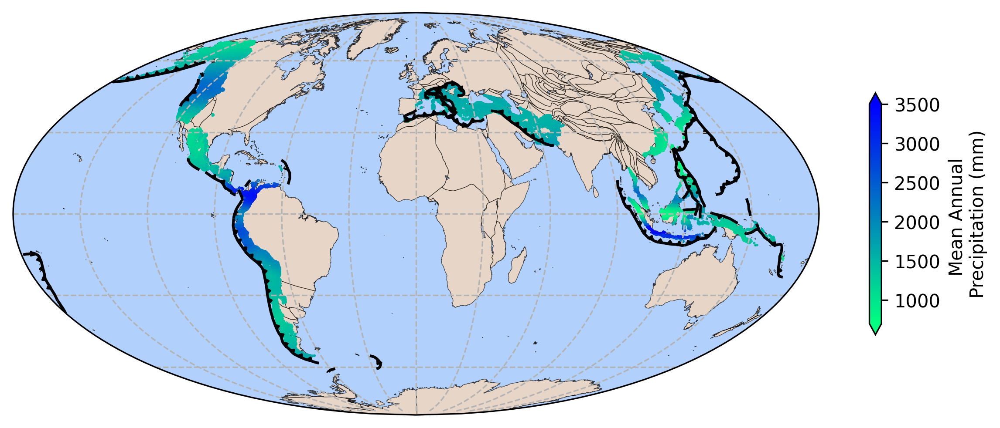

In [132]:
column='Mean Precipitation (mm)'
mollweide=True
features=True
cbar=True
figsize=[8,4]
fig = plt.figure(figsize=figsize, dpi=300)
vmin,vmax=700,3500
central_longitude=0
cmap="winter_r"
orientation='vertical'
extend='both'
shrink=0.5
# markersize=0.1
label=f'Mean Annual \nPrecipitation (mm)'
# label=f"$ \mathregular{{\Delta}}_{{PPT}}$ (m)"
# gplot = gplately.PlotTopologies(model, coastlines=coastlines, continents=continents, time=time)

if mollweide:
    ax = fig.add_subplot(111, projection=ccrs.Mollweide(central_longitude = central_longitude))
    ax.gridlines(color='0.7',linestyle='--', xlocs=np.arange(-180,180,30), ylocs=np.arange(-90,90,30))

    mollweide_proj = f"+proj=moll +lon_0={central_longitude} +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
    gdf_pointsc=gdf_points.to_crs(mollweide_proj).copy()
else:
    ax = fig.add_subplot(111, projection=ccrs.PlateCarree(central_longitude = central_longitude))
    ax.gridlines(color='0.7',linestyle='--', xlocs=np.arange(-180,180,15), ylocs=np.arange(-90,90,15))

# nc.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=500,vmin=-500,cmap=subtle, add_colorbar=False,robust=True,alpha=0.3)
      
    
if features:

    # Plot shapefile features, subduction zones and MOR boundaries at time Ma
    gplot.time = 0 # Ma
    # gplot.plot_continent_ocean_boundaries(ax, color='b', alpha=0.05)
    # gplot.plot_continents(ax, facecolor='palegoldenrod', alpha=0.2)
    # gplot.plot_continents(ax, facecolor='grey', alpha=0.2)
    gplot.plot_coastlines(ax, color='xkcd:light peach',edgecolor='k',alpha=0.7,lw=0.3)
    # gplot.plot_ridges_and_transforms(ax, color='red')
    gplot.plot_trenches(ax, color='k')
    gplot.plot_subduction_teeth(ax, color='k')


    # Plot the GeoDataFrame
# nc.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=500,vmin=-500,cmap=cmc.batlow, add_colorbar=True,robust=True,alpha=1.0,
#         cbar_kwargs={'orientation':'vertical','shrink':0.5,
#                                           'label':label})
    
# if quick:
#     da=df_to_NetCDF(x=gdf["Longitude"],y=gdf["Latitude"],z=gdf[column])
#     plot=gplot.plot_grid(ax=ax, grid=da,**{'cmap':cmap,'vmax':vmax,'vmin': vmin})
# else:
plot = gdf_pointsc.plot(ax=ax, cmap=cmap, column=column,markersize=0.1)
# topo_coarse.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap='grey', add_colorbar=False,robust=True,alpha=1.0)
   
if cbar:
    # Create a ScalarMappable object
    sm = cm.ScalarMappable(cmap=cmap)
    sm.set_array(gdf_pointsc[column])
    sm.set_clim(vmin, vmax)
    
    # Add colorbar using the same Axes object used for plotting
    colorbar = plt.colorbar(sm, ax=ax, orientation=orientation,shrink=shrink,extend=extend, label=label)
    colorbar.set_label(label)
ax.set_facecolor('xkcd:powder blue')
ax.set_global()
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/PPT.png")

## Global Explanation

In [113]:
mts_list=['Alaska-Yukon Ranges',
       # 'Anatolian / Armenian Highlands',
       'Balochistan Ranges',
       # 'Bismarck Archipelago', 
       'Caucasus Mountains',
       # 'Central America Volcanic Arc', 
       'Central Andes',
       # 'Central European Highlands', 
       # 'Chorotega Highlands*',
       # 'Chortís Highlands', 
       # 'Cordillera de la Costa',
       # 'Darien Isthmus Highlands*',
       # 'East European Highlands', 
       # 'Great Plains',
       'Hindu Kush', 
       # 'Indochinese Peninsula',
       # 'Intermountain West',
       'Iranian Plateau', 
       'Japanese Archipelago', 
       'Kamchatka Peninsula',
       # 'Kolyma Mountains', 
       # 'Korean Peninsula',
       # 'Koryak Mountains',
       'Lesser Antilles', 
       'Malay Archipelago',
       # 'Maya Highlands', 
       # 'Mediterranean islands',
       # 'Meseta Patagónica',
       # 'Mexican Highlands', 
       'Northern Andes', 
       'Pacific Coast Ranges',
       # 'Rocky Mountains', 
       # 'Sierra Madre de Chiapas',
       # 'Sierras Pampeanas',
       # 'Sikhote-Alin Area',
       # 'Sistema periférico',
       'Solomon Islands',
       # 'South China Mountains',
       'South European Highlands',
       # 'Southeast European Highlands', 
       'Southern Andes', 
       # 'Vanuatu Islands',
       # 'Venezuelan Coastal Range'
        ]

island arcs
noncollisional mountains
collisional mountains


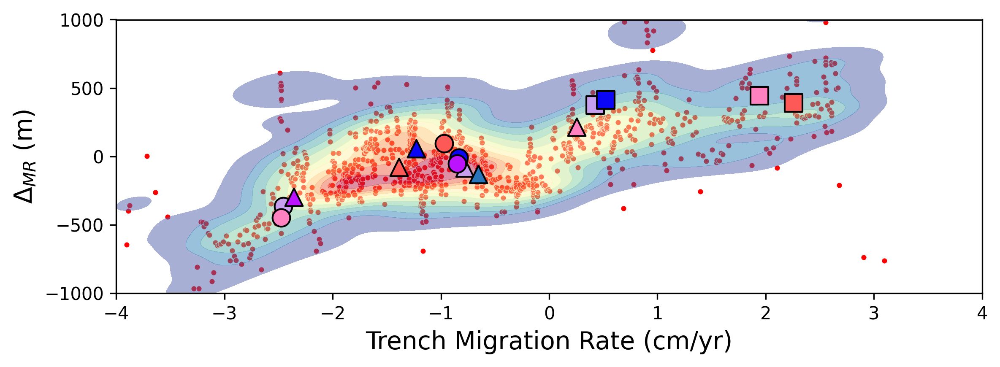

In [148]:

i=1
# Define the groups and their symbols


fig, ax = plt.subplots(figsize=[8, 3], dpi=300)
name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=10, ax=ax)
sns.kdeplot(x=x, y=y, fill=True, levels=12, cmap="Spectral_r", bw_adjust=0.7, alpha=0.5, ax=ax)

# Create a color counter for each group
color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Trench Migration Rate (cm/yr)']
    y = local_exp_mts.loc[mountain_name, 'Trench Migration Rate (cm/yr)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    ax.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6, 13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by

indices_to_remove = [0, 6,13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles= [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

# Create custom legend with grouped and individual entries
# plt.legend(handles=final_handles, loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=3, fontsize=6)

# Set x and y limits
plt.xlim([-4, 4])
plt.ylim([-1000, 1000])
plt.yticks(np.linspace(-1000, 1000, num=5))
# Set labels
ax.set_xlabel(f"Trench Migration Rate (cm/yr)",fontsize=14)
ax.set_ylabel(f"$ \mathregular{{\Delta}}_{{MR}}$ (m)",fontsize=14)
ax.grid(False)
# Adjust layout and show the plot
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Trench Migration Rate.png")
plt.show()


island arcs
noncollisional mountains
collisional mountains


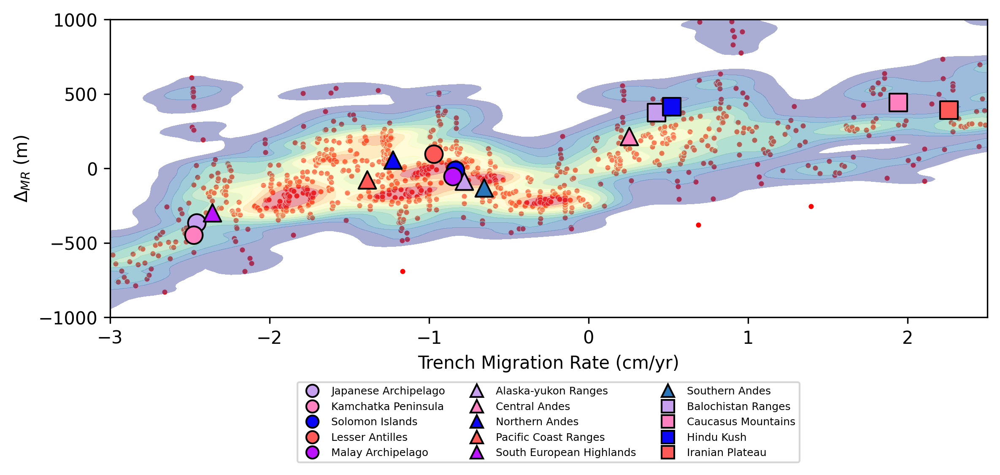

In [115]:

i=1

fig, ax = plt.subplots(figsize=[8, 4], dpi=300)
name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=10, ax=ax)
sns.kdeplot(x=x, y=y, fill=True, levels=12, cmap="Spectral_r", bw_adjust=0.4, alpha=0.5, ax=ax)

# Create a color counter for each group
color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Trench Migration Rate (cm/yr)']
    y = local_exp_mts.loc[mountain_name, 'Trench Migration Rate (cm/yr)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    ax.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6, 13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by

indices_to_remove = [0, 6,13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles= [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

# Create custom legend with grouped and individual entries
plt.legend(handles=final_handles, loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=3, fontsize=6)

# Set x and y limits
plt.xlim([-3, 2.5])
plt.ylim([-1000, 1000])
plt.yticks(np.linspace(-1000, 1000, num=5))
# Set labels
ax.set_xlabel(f"Trench Migration Rate (cm/yr)")
ax.set_ylabel(f"$ \mathregular{{\Delta}}_{{MR}}$ (m)")
ax.grid(False)
# Adjust layout and show the plot
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Trench Migration Rate_handle.png")
plt.show()


island arcs
noncollisional mountains
collisional mountains


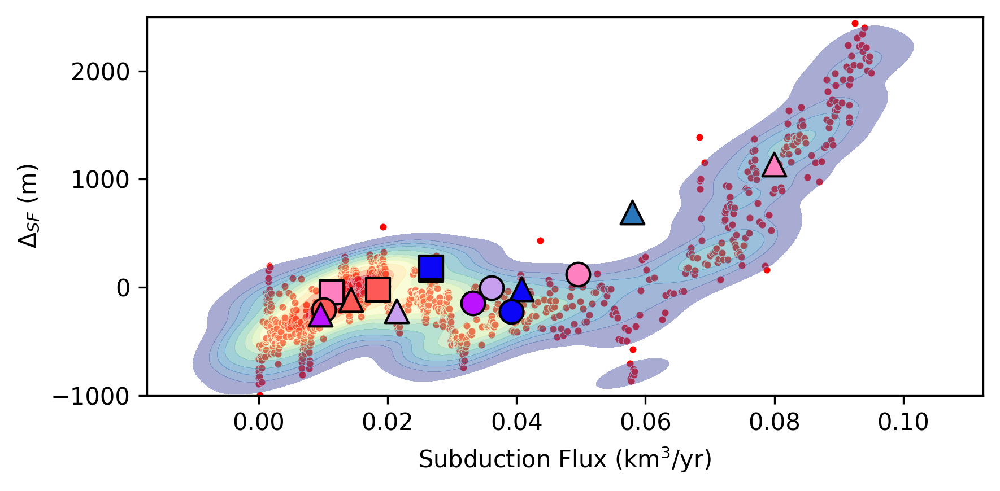

In [117]:

i = 0

# Prepare the plot
fig, ax = plt.subplots(figsize=[6, 3], dpi=300)
name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=10, ax=ax)
sns.kdeplot(x=x, y=y, fill=True, levels=12, cmap="Spectral_r", bw_adjust=0.7, alpha=0.5, ax=ax)

# Create a color counter for each group
color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Subduction Flux (km$^3$/yr)']
    y = local_exp_mts.loc[mountain_name, 'Subduction Flux (km$^3$/yr)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    ax.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6, 13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles = [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

# Set x and y limits
# ax.set_xlim([-4, 3.5])  # Uncomment and adjust if needed
ax.set_ylim([-1000, 2500])
ax.set_yticks(np.linspace(-1000, 2000, num=4))

# Set labels
ax.set_xlabel(f"Subduction Flux (km$^3$/yr)")
ax.set_ylabel(f"$ \mathregular{{\Delta}}_{{SF}}$ (m)")

# Enable or disable the grid using ax object
# ax.grid(True)  # Turn on the grid
ax.grid(False)  # Turn off the grid

# Adjust layout and show the plot
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/SF.png")
plt.show()


island arcs
noncollisional mountains
collisional mountains


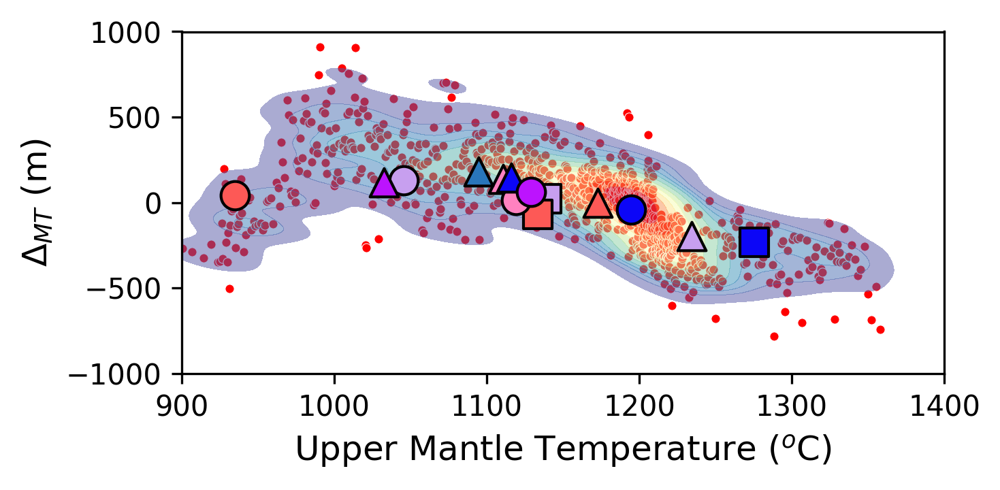

In [131]:


i=3



# Prepare the plot
plt.figure(figsize=[5, 2.5], dpi=300)
name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=10)
sns.kdeplot(x=x, y=y, fill=True, levels=12, cmap="Spectral_r", bw_adjust=0.7, alpha=0.5)

# Create a color counter for each group
color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Mantle Temperature ($^o$C)']
    y = local_exp_mts.loc[mountain_name, 'Mantle Temperature ($^o$C)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    plt.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6,13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles= [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

# Create custom legend with grouped and individual entries
# plt.legend(handles=final_handles, loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=3, fontsize=6)

# Set x and y limits
plt.xlim([900,1400])
plt.ylim([-1000, 1000])
plt.yticks(np.linspace(-1000, 1000, num=5))
# Set labels
plt.xlabel('Upper Mantle Temperature ($^o$C)', fontsize=12)
plt.ylabel(f"$ \mathregular{{\Delta}}_{{MT}}$ (m)", fontsize=12)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/MantleTemp.png")
# Adjust layout and show the plot

plt.show()


island arcs
noncollisional mountains
collisional mountains


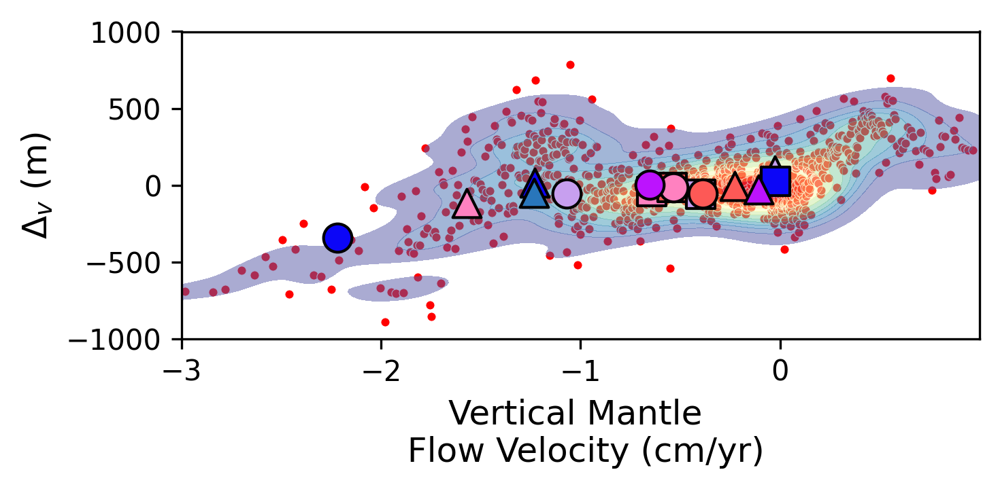

In [128]:


i=4

# Prepare the plot
plt.figure(figsize=[5, 2.5], dpi=300)
name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=10)
sns.kdeplot(x=x, y=y, fill=True, levels=12, cmap="Spectral_r", bw_adjust=0.7, alpha=0.5)

# Create a color counter for each group
color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Mantle Velocity (cm/yr)']
    y = local_exp_mts.loc[mountain_name,  'Mantle Velocity (cm/yr)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    plt.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6,13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles= [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

# Create custom legend with grouped and individual entries
# plt.legend(handles=final_handles, loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=3, fontsize=6)

# Set x and y limits
plt.xlim([-3,1])
plt.ylim([-1000, 1000])
plt.xticks(np.arange(-3, 1,1))
plt.yticks(np.linspace(-1000, 1000, num=5))
# Set labels
plt.xlabel(f"Vertical Mantle \n Flow Velocity (cm/yr)", fontsize=12)
plt.ylabel(f"$ \mathregular{{\Delta}}_{{v}}$ (m)", fontsize=12)

# Adjust layout and show the plot
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Mantlev.png")
plt.show()


island arcs
noncollisional mountains
collisional mountains


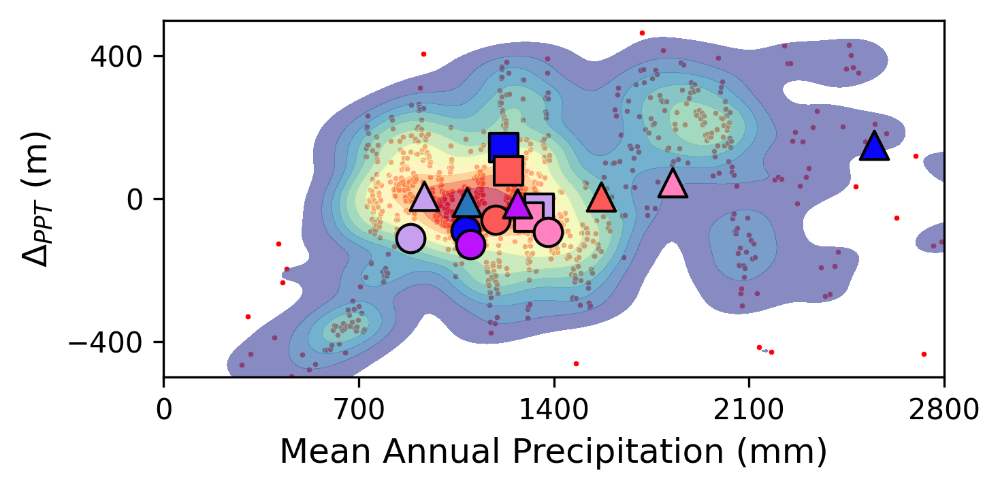

In [144]:
# plt.figure(figsize=[12,6])
i = 5
plt.figure(figsize=[5,2.5], dpi=300)
# name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']
# sns.kdeplot(x=x, y=1394 + y, cmap="Spectral_r", fill=True, bw_adjust=0.4)
# plt.scatter(x, y, alpha=0.4, edgecolors='blue', color='cornflowerblue', s=10)

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=4)
sns.kdeplot(x=x, y=y, fill=True, levels=12,cmap="Spectral_r",bw_adjust=0.7,alpha=0.7)

# plt.scatter(parameter_mts['Mean Precipitation (mm)'], local_exp_mts['Precipitation(Li)'],s=5,color='black')
texts=[]

color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Mean Precipitation (mm)']
    y = local_exp_mts.loc[mountain_name,  'Mean Precipitation (mm)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    plt.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6,13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles= [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

plt.xlim([0, 2500])
plt.ylim([-500, 500])

# Set x and y ticks
plt.xticks(np.linspace(00, 2800, num=5))  # Adjust the number of ticks as needed
plt.yticks(np.linspace(-400, 400, num=3))       # Adjust the number of ticks as needed

plt.xlabel("Mean Annual Precipitation (mm)",fontsize=12)
plt.ylabel(f"$ \mathregular{{\Delta}}_{{PPT}}$ (m)",fontsize=12) 

plt.tight_layout()
# plt.savefig(f"Figure/{name}_diff.png")
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Delta_PPT.png")
plt.show()


## Interactions 

In [141]:
def split_names(input_string):
    """
    Split the input string into two separate strings based on the '&' character.
    
    Parameters:
        input_string (str): The input string to be split.
    
    Returns:
        tuple: A tuple containing two separate strings.
    """
    split_strings = input_string.split('&')
    # Strip leading and trailing whitespace from each string
    split_strings = tuple(s.strip() for s in split_strings)
    return split_strings

In [142]:
i=7

left_col,right_col=split_names(names[i])
print(left_col,right_col)
X=explanation_dic["_internal_obj"]['specific'][i]['left_names']
Y=explanation_dic["_internal_obj"]['specific'][i]['right_names']
value=explanation_dic["_internal_obj"]['specific'][i]['scores']

X_new=[(X[i]+X[i+1])/2 for i in range(len(X)-1)]
Y_new=[(Y[i]+Y[i+1])/2 for i in range(len(Y)-1)]

x=[]
y=[]
new_values=[]

for k in range(len(X_new)):
    for j in range(len(Y_new)):
        new_values.append(value[k,j])
        x.append(X_new[k])
        y.append(Y_new[j])

interactions=pd.DataFrame()
interactions[left_col]=x
interactions[right_col]=y
interactions['Value']=new_values
# plt.imshow(value,vmin=np.mean(value)-2*np.std(value),vmax=np.mean(value)+2*np.std(value),cmap='gist_earth')

Subduction Flux (km$^3$/yr) Trench Distance (km)


In [143]:
interactions[right_col]=interactions[right_col]*111

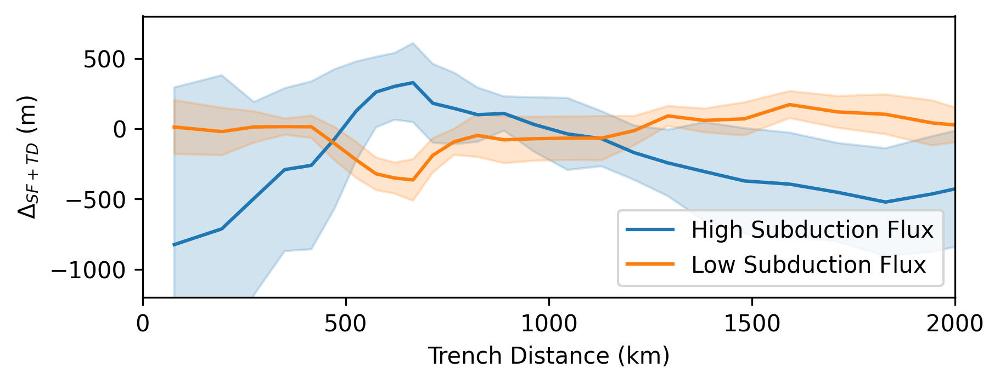

In [145]:
# import seaborn as sns
# import matplotlib.pyplot as plt

# Assuming 'grouped' DataFrame is already defined
interactionsc0 = interactions[interactions[left_col] > 0.03].copy()
interactionsc8 = interactions[interactions[left_col] < 0.02].copy()

plt.figure(figsize=[6,2.5],dpi=300)
# Plot the mean values with uncertainty
sns.lineplot(data=interactionsc0, x="Trench Distance (km)", y="Value", label="High Subduction Flux", errorbar="sd")
sns.lineplot(data=interactionsc8, x="Trench Distance (km)", y="Value", label="Low Subduction Flux", errorbar="sd")

# Add labels and title
plt.xlabel("Trench Distance (km)")
plt.ylabel(f"$ \mathregular{{\Delta}}_{{SF + TD}}$ (m)")
# plt.title("Mean Value with Uncertainty")
plt.yticks(np.linspace(-1000, 1000, num=5))
plt.xticks(np.linspace(0, 2000, num=5))
plt.tight_layout()
plt.xlim([0,2000])
plt.ylim([-1200,800])
# plt.grid(visible=False)
# Show legend

plt.legend(loc='lower right')
plt.savefig(f"{OUTPUT_FOLDER}/Figure/TD_SF.png")
# Show plot
plt.show()


# Exporting the output as NetCDF, Shapefiles and gpkg

## Exporting Parameters:

### All Parameters

In [66]:
create_directory_if_not_exists(f"{DEFAULT_OUTPUT_NetCDF}/All_Parameters")
## as shapefile
gdf_points=gpd.GeoDataFrame(featuresc,geometry=gpd.points_from_xy(TrainingData['Longitude'],TrainingData['Latitude']))
gdf_points=gdf_points.set_crs("EPSG:4326")
gdf_points.to_file(f"{DEFAULT_OUTPUT_CSV}/All_Parameters.shp")
gdf_points.to_file(f"{DEFAULT_OUTPUT_CSV}/All_Parameters.gpkg")

## as netcdf

for column in featuresc.columns:
    # Clean the column name to remove forward slashes and other special characters
    clean_column_name = column.replace('/', '_').replace('(', '').replace(')', '').replace('^', '').replace('$', '').replace(' ', '_')

    # Ensure the data is numeric, converting any invalid entries to NaN
    z_values = pd.to_numeric(featuresc[column], errors='coerce')

    nc=df_to_NetCDF(x=TrainingData['Longitude'],y=TrainingData['Latitude'],z=featuresc[column],grid_resolution=NETCDF_GRID_RESOLUTION)
    nc.to_netcdf(f"{DEFAULT_OUTPUT_NetCDF}/All_Parameters/{clean_column_name}.nc")

### Explanations


In [65]:
create_directory_if_not_exists(f"{DEFAULT_OUTPUT_NetCDF}/Geospatial_Explanation")
## as shapefile
local_exp_gdf.to_file(f"{DEFAULT_OUTPUT_CSV}/Geospatial_Explanation.shp")
local_exp_gdf.to_file(f"{DEFAULT_OUTPUT_CSV}/Geospatial_Explanation.gpkg")
## as netcdf

for column in local_exp_gdf.columns:
    try:
        # Clean the column name to remove forward slashes and other special characters
        clean_column_name = column.replace('/', '_').replace('(', '').replace(')', '').replace('^', '').replace('$', '').replace(' ', '_')
        
        # Ensure the data is numeric, converting any invalid entries to NaN
        z_values = pd.to_numeric(local_exp_gdf[column], errors='coerce')

        # Proceed with the NetCDF creation
        nc = df_to_NetCDF(x=local_exp_gdf.geometry.x, y=local_exp_gdf.geometry.y, z=z_values, grid_resolution=NETCDF_GRID_RESOLUTION)
        nc.name = clean_column_name

        # Save the NetCDF file
        nc.to_netcdf(f"{DEFAULT_OUTPUT_NetCDF}/Geospatial_Explanation/EBM_{clean_column_name}.nc")

    except Exception as e:
        print(f"Error processing column '{column}': {e}")
